# 1. Systems of Linear Equations and Matrices

A general linear system of $m$ equations in the $n$ unknowns $x_1,x_2, ..., x_n$ can be written as
\begin{equation}
		a_{11}x_{1} + a_{12}x_{2} + \dots + a_{1n}x_{n} = b_{1} \\
        a_{21}x_{1} + a_{22}x_{2} + \dots + a_{2n}x_{n} = b_{2} \\
        \vdots  \quad \quad \vdots \quad \quad \vdots \\
        a_{m1}x_{1} + a_{m2}x_{2} + \dots + a_{mn}x_{n} = b_{m}
\end{equation}

A solution of a linear system in $n$ unknowns $x_1,x_2, ..., x_n$ is a sequence of $n$ numbers $s_1,s_2, ..., s_n$  for which the substitution
\begin{equation}
    x_1 = s_1, \quad x_2 = s_2, \quad \dots , x_n = s_n 
\end{equation}

## 1.1. Introduction to Systems of Linear Equations

### 1. A Linear System with One Solution

The solution is unique (a single point).

In [16]:
A = [1 -1;
     2 1]

b = [1;
     6]

x = A \ b 

2-element Vector{Float64}:
 2.3333333333333335
 1.3333333333333333

### 2. A Linear System with No Solutions

One equation is contradictory to another equation in the system.  Geometrically, there is no intersection between the planes or lines / parallel planes or parallel lines.

In [17]:
A = [1 1;
     2 2]

b = [1;
     6]

x = A \ b 

LoadError: LinearAlgebra.SingularException(2)

### 3. A Linear System with Infinitely Many Solutions

The solutions can be expressed as parametric equations that can be assigned by any numerical values, thus having infinitely many solutions. 

In [21]:
# The second and the third equations are multiples of the first equation
# Just use the first equation and assign the solution with parametric equations of
# z = s, y = r, and x =  5 + r - 2s

A = [1 -1 2;
     2 -2 4;
     3 -3 6]

b = [5;
     10;
     15]

x = A \ b 

LoadError: LinearAlgebra.SingularException(2)

## 1.2. Gaussian Elimination

When considering methods for solving systems of linear equations, it is important to distinguish between large system that must be solved by computer and small systems that can be solved by hand.

Large systems require special techniques to deal with issues of memory size, roundoff errors, solution time, etc.

#### Reduced row echelon form' properties:
1. The first nonzero number in the row is a `1` and is called the leading 1
2. If there are any rows that consist entirely of zeros, then they are grouped together at the bottom of the matrix
3. The leading 1 in the lower row occurs farther to the right than the leading 1 in the higher row
4. Each column that contains a leading 1 has zeros everywhere else in that column

A matrix with properties 1-3 is said to be in `row echelon form`, while a matrix with properties 1-4 is in `reduced row echelon form`.

#### Homogeneous Linear Systems
A system of linear equations is said to be homogeneous if the constant terms are all zero
\begin{equation}
		a_{11}x_{1} + a_{12}x_{2} + \dots + a_{1n}x_{n} = 0 \\
        a_{21}x_{1} + a_{22}x_{2} + \dots + a_{2n}x_{n} = 0 \\
        \vdots  \quad \quad \vdots \quad \quad \vdots \\
        a_{m1}x_{1} + a_{m2}x_{2} + \dots + a_{mn}x_{n} = 0
\end{equation}

The possible solutions for homogeneous systems:
1. Trivial solution ($x_1=0, x_2=0, ...,x_n=0$)
2. Infinitely many solutions

In [ ]:
A = [1 3 -2 0 2 0;
     2 6 -5 -2 4 -3;
     0 0 5 10 0 15;
     2 6 0 8 4 18]

b = [0;
     -1;
     5;
     6]

In [3]:
# solves Ax = b by (essentially) Gaussian elimination
x = A \ b 

4-element Vector{Float64}:
  3.144781144781145
  2.6734006734006743
 -9.922558922558922
 10.936026936026934

In [4]:
@time A \ b ;

  0.000036 seconds (3 allocations: 384 bytes)


#### Reduced Row Echelon Form

In [2]:
# rrefx -- reduced row echelon form
using LinearAlgebraX
A = [0 0 -2 0 7 12;
     2 4 -10 6 12 28;
     2 4 -5 6 -5 -1]
rrefx(A)

3×6 Matrix{Rational{BigInt}}:
 1//1  2//1  0//1  3//1  0//1  7//1
 0//1  0//1  1//1  0//1  0//1  1//1
 0//1  0//1  0//1  0//1  1//1  2//1

In [7]:
#Change result to Float
Float64.(rrefx(A))

3×6 Matrix{Float64}:
 1.0  2.0  0.0  3.0  0.0  7.0
 0.0  0.0  1.0  0.0  0.0  1.0
 0.0  0.0  0.0  0.0  1.0  2.0

In [8]:
#Change result to Float, alternative 2
convert(Matrix{Float64}, rrefx(A))

3×6 Matrix{Float64}:
 1.0  2.0  0.0  3.0  0.0  7.0
 0.0  0.0  1.0  0.0  0.0  1.0
 0.0  0.0  0.0  0.0  1.0  2.0

In [3]:
@time rrefx(A) ;

  0.000171 seconds (899 allocations: 30.656 KiB)


In [5]:
B = [1 3 -2 0 2 0 0;
     2 6 -5 -2 4 -3 0;
     0 0 5 10 0 15 0;
     2 6 0 8 4 18 0]
rrefx(B)

4×7 Matrix{Rational{BigInt}}:
 1//1  3//1  0//1  4//1  2//1  0//1  0//1
 0//1  0//1  1//1  2//1  0//1  0//1  0//1
 0//1  0//1  0//1  0//1  0//1  1//1  0//1
 0//1  0//1  0//1  0//1  0//1  0//1  0//1

In [6]:
@time rrefx(B) ;

  0.000233 seconds (1.39 k allocations: 48.414 KiB)


#### Homogeneous Linear Systems

In [15]:
using LinearAlgebraX
A = [1 3 -2 0 2 0 0;
     2 6 -5 -2 4 -3 0;
     0 0 5 10 0 15 0;
     2 6 0 8 4 18 0]
Float64.(rrefx(A))

4×7 Matrix{Float64}:
 1.0  3.0  0.0  4.0  2.0  0.0  0.0
 0.0  0.0  1.0  2.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  1.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0

Solving for leading variables and assign the rest of variables as parameters to obtain the solution set parametrically.

If a homogeneous linear system has `n` unknowns and if the reduced row echelon form of its augmented matrix has `r` nonzero rows, then the system has `n-r` free variables.

#### Gaussian Elimination Function

I have found this code, and it is faster than the `A \ b`

Source: https://github.com/AugustoCL/gauss_jordan_elimination

In [23]:
using LinearAlgebra, BenchmarkTools

function swap_rows(i::T, nlinha::T) where {T<:Integer}
    for n ∈ (i+1):nlinha        # iterate over lines above to check if could be swap
        if A[n,i] ≠ 0.0         # condition to swap row
            L = copy(A[i,:])    # copy line to swap
            A[i,:] = A[n,:]     # swap occur
            A[n,:] = L
            break
        end
    end
end

function gauss_jordan(A::Matrix{T}) where {T<:Number}
    
    # convert to float to avoid InexactError: Int64()
    (T <: Integer) && (A = convert.(Float64, A))

    # check if matrix is singular
    m, n = size(A)
    if m == n
        @assert det(A) ≠ 0.0 "Must insert a non-singular matrix"
    else
        @assert det(A[:,1:end-1]) ≠ 0.0 "Must insert a non-singular matrix or a system matrix [A b]"
    end

    for i ∈ axes(A, 1)
        if A[i,i] == 0.0                            # check if need swap rows
            swap_rows(i, m)
        end

        @. A[i,:] = A[i,:] / A[i,i]                 # divide pivot line by pivot element

        for j ∈ axes(A, 1)                          # iterate each line for each pivot column, except pivot line
            if j ≠ i                                # jump pivot line
                @. A[j,:] = A[j,:] - A[i,:]*A[j,i]  # apply gauss jordan in each line
            end
        end
    end

    return A
end

gauss_jordan (generic function with 1 method)

In [24]:
A = [1.5 2 -4 3; 
     3 -1 -6 8; 
     -10 2.3 4 5]

3×4 Matrix{Float64}:
   1.5   2.0  -4.0  3.0
   3.0  -1.0  -6.0  8.0
 -10.0   2.3   4.0  5.0

In [25]:
@time gauss_jordan(A)

  1.015294 seconds (86.38 k allocations: 4.144 MiB, 99.99% compilation time)


3×4 Matrix{Float64}:
  1.0   0.0  0.0  -1.52884
 -0.0   1.0  0.0  -1.16166
 -0.0  -0.0  1.0  -1.90414

In [26]:
@btime gauss_jordan(A)

  4.707 μs (17 allocations: 1.61 KiB)


3×4 Matrix{Float64}:
 1.0  0.0  0.0  -1.52884
 0.0  1.0  0.0  -1.16166
 0.0  0.0  1.0  -1.90414

In [27]:
A = [1.5 2 -4; 
     3 -1 -6; 
     -10 2.3 4]

3×3 Matrix{Float64}:
   1.5   2.0  -4.0
   3.0  -1.0  -6.0
 -10.0   2.3   4.0

In [28]:
b = [3; 8; 5]

3-element Vector{Int64}:
 3
 8
 5

In [29]:
@time A \ b

  0.000043 seconds (3 allocations: 288 bytes)


3-element Vector{Float64}:
 -1.5288383428107228
 -1.1616571892770102
 -1.9041429731925263

In [30]:
@btime A \ b

  3.765 μs (3 allocations: 288 bytes)


3-element Vector{Float64}:
 -1.5288383428107228
 -1.1616571892770102
 -1.9041429731925263

#### Gaussian Elimination with "LU" Factorization

In [1]:
# Gaussian elimination is really “LU” factorization, performed by the built-in function lu
# LU factorization (Gaussian elimination) of the augumented matrix [A b],
# passing the undocumented option Val{false} to prevent row re-ordering

using LinearAlgebra

# Make sure that U[k,:] is treated as a row vector for your rank-1 update
function lu_nopivot(A)
    n = size(A, 1)
    L = Matrix{eltype(A)}(I, n, n)
    U = copy(A)
    for k = 1:n
        L[k+1:n,k] = U[k+1:n,k] / U[k,k]
        U[k+1:n,:] = U[k+1:n,:] - L[k+1:n,k]*transpose(U[k,:])
    end
    return L, U
end

lu_nopivot (generic function with 1 method)

In [2]:
A = [1.5 2 -4; 
     3 -1 -6; 
     -10 2.3 4]

3×3 Matrix{Float64}:
   1.5   2.0  -4.0
   3.0  -1.0  -6.0
 -10.0   2.3   4.0

In [4]:
L, U = lu_nopivot(A);

In [5]:
# type L or U
L

3×3 Matrix{Float64}:
  1.0       0.0      0.0
  2.0       1.0      0.0
 -6.66667  -3.12667  1.0

In [6]:
U

3×3 Matrix{Float64}:
 1.5   2.0   -4.0
 0.0  -5.0    2.0
 0.0   0.0  -16.4133

### An Example of the Hamming code

Insert Identity matrix above P matrix

In [2]:
using LinearAlgebra

P = [1 1 1 0; 0 1 1 1; 1 0 1 1]

Gtrans = vcat(Matrix{Int}(I, 4, 4), P)

7×4 Matrix{Int64}:
 1  0  0  0
 0  1  0  0
 0  0  1  0
 0  0  0  1
 1  1  1  0
 0  1  1  1
 1  0  1  1

### Visualize Gaussian-Elimination

In [3]:
"""
TwoMatrices is just a wrapper type around two matrices or vectors with the same
number of rows, so that they can be displayed side-by-side with a title and
and arrow pointing from left to right.
"""
type TwoMatrices
    left::AbstractVecOrMat
    right::AbstractVecOrMat
    title::AbstractString
    function TwoMatrices(left, right, title="")
        size(left,1) == size(right,1) || throw(DimensionMismatch("two matrices must have same # of columns and rows"))
        return new(left, right, title)
    end
end

function Base.show(io::IO, ::MIME"text/plain", x::TwoMatrices)
isempty(x.title) || println(io, x.title)
m = size(x.left, 1)
s = [Text(" "^10) for i in 1:m]
s[(m+1)÷2] = Text(" ---> ")
Base.showarray(io, [x.left s x.right], false; header=false)
end

LoadError: syntax: extra token "TwoMatrices" after end of expression

In [4]:
"""
naive_gauss(A, [step])

Given a matrix ‘A‘, performs Gaussian elimination to convert
‘A‘ into an upper-triangular matrix ‘U‘.

This implementation is "naive" because it *never re-orders the rows*.
(It will obviously fail if a zero pivot is encountered.)

If the optional ‘step‘ argument is supplied, only performs ‘step‘
steps of Gaussian elimination.

Returns ‘(U, row, col, factor)‘, where ‘row‘ and ‘col‘ are the
row and column of the last step performed, while ‘factor‘
is the last factor multiplying the pivot row.
"""

function naive_gauss(A, step=typemax(Int))
        m = size(A,1) # number of rows
        factor = A[1,1]/A[1,1]
        step ≤ 0 && return (A, 1, 1, factor)
        U = copy!(similar(A, typeof(factor)), A)
        for j = 1:m # loop over m columns
            for i = j+1:m # loop over rows below the pivot row j
                # subtract a multiple of the pivot row (j)
                # from the current row (i) to cancel U[i,j] = U[U+1D62][U+2C7C]:
                factor = -U[i,j]/U[j,j]
                U[i,:] = U[i,:] + U[j,:] * factor
                step -= 1
                step ≤ 0 && return (U, i, j, factor)
        end
    end
    return U, m, m, factor
end

naive_gauss (generic function with 2 methods)

In [5]:
using Interact
# For display, I only want to show 3 decimal places of floating-point values,
# but I want to show integers and similar types exactly, so I define a little
# function to do this rounding

shorten(x::AbstractFloat) = round(x, 3)
shorten(x) = x # leave non floating-point values as-is

# create an interactive widget to visualize the Gaussian-elimination process for the matrix A.
function visualize_gauss(A)
    m = size(A, 1)
    @manipulate for step in slider(1:(m*(m-1))÷2, value=1, label="gauss step")
        Uprev, = naive_gauss(A, step-1)
        U, row, col, factor = naive_gauss(A, step)
        pivot = U[col,col]
        TwoMatrices(shorten.(Uprev), shorten.(U), "Gaussian elimination for column $col with pivot")
    end
end

WebIO._IJuliaInit()

visualize_gauss (generic function with 1 method)

In [6]:
visualize_gauss(A)

LoadError: MethodError: no method matching round(::Float64, ::Int64)
[0mClosest candidates are:
[0m  round(::T, [91m::RoundingMode{:NearestTiesUp}[39m) where T<:AbstractFloat at ~/julia-1.7.3/share/julia/base/floatfuncs.jl:220
[0m  round([91m::Type{T}[39m, ::Integer) where T<:Integer at ~/julia-1.7.3/share/julia/base/int.jl:645
[0m  round(::AbstractFloat, [91m::RoundingMode{:NearestTiesAway}[39m) at ~/julia-1.7.3/share/julia/base/floatfuncs.jl:215
[0m  ...

In [13]:
visualize_gauss(rand(-9.0:9.0,5,5))

LoadError: MethodError: no method matching round(::Float64, ::Int64)
[0mClosest candidates are:
[0m  round(::T, [91m::RoundingMode{:NearestTiesUp}[39m) where T<:AbstractFloat at ~/julia-1.7.3/share/julia/base/floatfuncs.jl:220
[0m  round([91m::Type{T}[39m, ::Integer) where T<:Integer at ~/julia-1.7.3/share/julia/base/int.jl:645
[0m  round(::AbstractFloat, [91m::RoundingMode{:NearestTiesAway}[39m) at ~/julia-1.7.3/share/julia/base/floatfuncs.jl:215
[0m  ...

In [11]:
Abad = [-3 5 5 3 -7;
        3 -5 8 -8 -6;
        8 2 8 2 -8;
        -6 -2 6 4 -8;
        -8 4 -6 -1 8;]

5×5 Matrix{Int64}:
 -3   5   5   3  -7
  3  -5   8  -8  -6
  8   2   8   2  -8
 -6  -2   6   4  -8
 -8   4  -6  -1   8

In [12]:
visualize_gauss(Abad)

LoadError: MethodError: no method matching round(::Float64, ::Int64)
[0mClosest candidates are:
[0m  round(::T, [91m::RoundingMode{:NearestTiesUp}[39m) where T<:AbstractFloat at ~/julia-1.7.3/share/julia/base/floatfuncs.jl:220
[0m  round([91m::Type{T}[39m, ::Integer) where T<:Integer at ~/julia-1.7.3/share/julia/base/int.jl:645
[0m  round(::AbstractFloat, [91m::RoundingMode{:NearestTiesAway}[39m) at ~/julia-1.7.3/share/julia/base/floatfuncs.jl:215
[0m  ...

In [25]:
det(Abad)

19211.999999999996

In [26]:
# Visualize the process for larger matrices by using images, 
# with the PyPlot package (a wrapper around the Python Matplotlib library)

using PyPlot

m = 100
Abig = randn(m,m)
fig = figure()
nsteps = (m*(m-1))÷2
@manipulate for step in slider(0:50:nsteps, value=2, label="gauss step")
    withfig(fig) do
        U, row, col = naive_gauss(Abig, step)
        # I had to experiment a little to find a nice way to plot this
        imshow(log10.(abs.(U) .+ 1), cmap="hot", vmin=0, vmax=3)
        title("step $step: column $col, row $row")
        colorbar(label=L"\log_{10}(|U_{i,j}| + 1)")
    end
end

# Analyze the computational cost of Gaussian elimination and how it scales with the size of the matrix 

Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Scope(Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :label), Any["gauss step"], Dict{Symbol, Any}(:className => "interact ", :style => Dict{Any, Any}(:padding => "5px 10px 0px 10px")))], Dict{Symbol, Any}(:className => "interact-flex-row-left")), Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :input), Any[], Dict{Symbol, Any}(:max => 100, :min => 1, :attributes => Dict{Any, Any}(:type => "range", Symbol("data-bind") => "numericValue: index, valueUpdate: 'input', event: {change: function (){this.changes(this.changes()+1)}}", "orient" => "horizontal"), :step => 1, :className => "slider slider is-fullwidth", :style => Dict{Any, Any}()))], Dict{Symbol, Any}(:className => "interact-flex-row-center")), Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :p), Any[], Dict{Symbol, Any}(:attributes => Dict("data-bind" => "text: formatted_val")))], Dict{Symbol, Any}(:className => "interact-flex-row-right"))], Dict{Symbol, Any}(:className => "interact-flex-row interact-widget")), Dict{String, Tuple{Observables.AbstractObservable, Union{Nothing, Bool}}}("changes" => (Observable{Int64} with 1 listeners. Value:
0, nothing), "index" => (Observable{Any} with 2 listeners. Value:
2, nothing)), Set{String}(), nothing, Asset[Asset("js", "knockout", "/home/browni/.julia/packages/Knockout/3gjS1/src/../assets/knockout.js"), Asset("js", "knockout_punches", "/home/browni/.julia/packages/Knockout/3gjS1/src/../assets/knockout_punches.js"), Asset("js", nothing, "/home/browni/.julia/packages/InteractBase/h8Fwe/src/../assets/all.js"), Asset("css", nothing, "/home/browni/.julia/packages/InteractBase/h8Fwe/src/../assets/style.css"), Asset("css", nothing, "/home/browni/.julia/packages/Interact/pVyN2/src/../assets/bulma_confined.min.css")], Dict{Any, Any}("changes" => Any[WebIO.JSString("(function (val){return (val!=this.model[\"changes\"]()) ? (this.valueFromJulia[\"changes\"]=true, this.model[\"changes\"](val)) : undefined})")], "index" => Any[WebIO.JSString("(function (val){return (val!=this.model[\"index\"]()) ? (this.valueFromJulia[\"index\"]=true, this.model[\"index\"](val)) : undefined})")]), WebIO.ConnectionPool(Channel{Any}(32), Set{AbstractConnection}(), Condition(Base.InvasiveLinkedList{Task}(Task (runnable) @0x00007f1ce0ba1fb0, Task (runnable) @0x00007f1ce0ba1fb0), Base.AlwaysLockedST(1))), WebIO.JSString[WebIO.JSString("function () {\n    var handler = (function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init: function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            });\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\"-0\", \"-0.\"].indexOf(stringified()) >= 0))\n                     return;\n                 if ([\"null\", \"\"].indexOf(str) >= 0)\n                     return;\n                stringified(str);\n            });\n            ko.applyBindingsToNode(\n                element,\n                {\n                    value: stringified,\n                    valueUpdate: allBindings.get('valueUpdate'),\n                },\n                context,\n            );\n        }\n    };\n    var json_data = {\"formatted_vals\":[\"0\",\"50\",\"100\",\"150\",\"200\",\"250\",\"300\",\"350\",\"400\",\"450\",\"500\",\"550\",\"600\",\"650\",\"700\",\"750\",\"800\",\"850\",\"900\",\"950\",\"1000\",\"1050\",\"1100\",\"1150\",\"1200\",\"1250\",\"1300\",\"1350\",\"1400\",\"1450\",\"1500\",\"1550\",\"1

## 1.3. Matrices and Matrix Operations

A matrix is a rectangular array of numbers. The numbers in the array are called the entries in the matrix.

Two matrices are defined to be equal if they have the same size and their corresponding entries are equal.

In [9]:
# How to create a 2x3 matrix from row vectors #1
# Vectors are by default treated as columns in Julia.
# For real vectors and matrices, the adjoint (Hermitian conjugate) is the same as transpose. 
a = [1, 2, 3]
b = [10,20,30]
m2x3 = transpose(hcat(a,b))


2×3 transpose(::Matrix{Int64}) with eltype Int64:
  1   2   3
 10  20  30

In [10]:
# How to create a 2x3 matrix from row vectors #2
a = [1, 2, 3]
b = [10,20,30]
m2x3 = [a' ; b']

2×3 Matrix{Int64}:
  1   2   3
 10  20  30

In [11]:
# How to create a 2x3 matrix from row vectors #3
a = [1, 2, 3]
b = [10,20,30]
m2x3 = [transpose(a); transpose(b)]

2×3 Matrix{Int64}:
  1   2   3
 10  20  30

In [12]:
# Alternative: [1:2  4:5  7:8]
[[1,2]  [4,5]  [7,8]]

2×3 Matrix{Int64}:
 1  4  7
 2  5  8

In [14]:
A = [8 1 3 1
1 7 1 -1
3 11 7 6
7 9 4 6]

4×4 Matrix{Int64}:
 8   1  3   1
 1   7  1  -1
 3  11  7   6
 7   9  4   6

In [15]:
b = [9, 1, 35, 72]

4-element Vector{Int64}:
  9
  1
 35
 72

#### Addition and Subtraction

In [3]:
A = [2 1 0 3;
    -1 0 2 4;
     4 -2 7 0]

B = [-4 3 5 1;
     2 2 0 -1;
     3 2 -4 5]

3×4 Matrix{Int64}:
 -4  3   5   1
  2  2   0  -1
  3  2  -4   5

In [4]:
A+B

3×4 Matrix{Int64}:
 -2  4  5  4
  1  2  2  3
  7  0  3  5

In [5]:
A-B

3×4 Matrix{Int64}:
  6  -2  -5   2
 -3  -2   2   5
  1  -4  11  -5

#### Multiplying Matrices

If A is an $m \times r$ matrix and B is an $r \times n$ matrix, then the product AB is the $m \times n$ matrix.

The number of columns of the first factor A must be the same as the number of rows of the second factor B in order to form the product AB.

In [6]:
A = [1 2 4;
     2 6 0]

B = [4 1 4 3;
     0 -1 3 1;
     2 7 5 2]

3×4 Matrix{Int64}:
 4   1  4  3
 0  -1  3  1
 2   7  5  2

In [7]:
A*B

2×4 Matrix{Int64}:
 12  27  30  13
  8  -4  26  12

#### Linear Combinations

The product $A \boldsymbol{x}$ can be expressed as a linear combination of the column vectors of $A$ in which the coefficients are the entries of $\boldsymbol{x}$.

\begin{equation} A =
\begin{bmatrix}
        a_{11} & a_{12} & \dots & a_{1n} \\
        a_{21} & a_{22} & \dots & a_{2n} \\
        \vdots & \vdots & \ & \vdots \\
        a_{m1} & a_{m2} & \dots & a_{mn}
\end{bmatrix} 
\quad \text{and} \quad x = 
\begin{bmatrix}
        x_{1}  \\
        x_{2}  \\
        \vdots  \\
        x_{n} 
\end{bmatrix} 
\end{equation}

\begin{equation} A\boldsymbol{x} =
\begin{bmatrix}
        a_{11}x_1 & a_{12}x_2 & \dots & a_{1n}x_n \\
        a_{21}x_1 & a_{22}x_2 & \dots & a_{2n}x_n \\
        \vdots & \vdots & \ & \vdots \\
        a_{m1}x_1 & a_{m2}x_2 & \dots & a_{mn}x_n
\end{bmatrix}  
= x_{1}
\begin{bmatrix}
        a_{11}  \\
        a_{21}  \\
        \vdots  \\
        a_{m1} 
\end{bmatrix} 
+ x_{2}
\begin{bmatrix}
        a_{12}  \\
        a_{22}  \\
        \vdots  \\
        a_{m2} 
\end{bmatrix}
+ \dots + x_{n}
\begin{bmatrix}
        a_{1n}  \\
        a_{2n}  \\
        \vdots  \\
        a_{mn} 
\end{bmatrix} 
\end{equation}



If $Ax = \boldsymbol{b}$, then b is a linear combination of the columns of A. 

\begin{equation}
\begin{bmatrix}
        a_{11}x_1 & a_{12}x_2 & \dots & a_{1n}x_n \\
        a_{21}x_1 & a_{22}x_2 & \dots & a_{2n}x_n \\
        \vdots & \vdots & \ & \vdots \\
        a_{m1}x_1 & a_{m2}x_2 & \dots & a_{mn}x_n
\end{bmatrix} =
\begin{bmatrix}
        b_{1}  \\
        b_{2}  \\
        \vdots  \\
        b_{m} 
\end{bmatrix} 
\end{equation}

#### Transpose of a matrix

This two matrix operations have no analogs in the arithmetic of real numbers

If $A$ is any $m \times n$ matrix, then the transpose of $A$, denoted by $A^{T}$, is defined to be the $n \times m$ matrix that results by interchanging the rows and columns of $A$.

The first column of $A$ is the first row of $A^{T}$, the second column of $A$ is the second row of $A^{T}$, and so forth.

In [18]:
A = [1 -2 4;
     3 7 0;
     -5 8 6]

3×3 Matrix{Int64}:
  1  -2  4
  3   7  0
 -5   8  6

In [19]:
transpose(A)

3×3 transpose(::Matrix{Int64}) with eltype Int64:
  1  3  -5
 -2  7   8
  4  0   6

#### Trace of a Matrix

The trace of a matrix $A$ denoted by tr$(A)$, is defined to be the sum of the entries on the main diagonal of $A$. The trace of $A$ is not defined if $A$ is not a square matrix.

\begin{equation}
tr(A) = \Sigma_{i=1}^{n} a_{ii}
\end{equation}

In [21]:
using LinearAlgebra
tr(A)

14

## 1.4. Inverses; Algebraic Properties of Matrices

#### Properties of Matrix Arithmetic

(a) $A + B = B + A$

(b) $A +(B + C) = (A + B) + C$

(c) $A(BC) = (AB)C$

(d) $A(B+C) = AB + AC$

(e) $(B+C)A = BA + CA$

(f) $A(B-C) = AB - AC$

(g) $(B-C)A = BA - CA$

(h) $a(B+C) = aB + aC$

(i) $a(B-C) = aB - aC$

(j) $(a+b)C = aC + bC$

(k) $(a-b)C = aC - bC$

(l) $a(bC) = (ab)C$

(m) $a(BC) = (aB)C = B(aC)$

In [23]:
A = [1 2;
     3 4;
     5 6]

B = [4 5;
     6 7]

C = [6 7;
     8 4]

2×2 Matrix{Int64}:
 6  7
 8  4

In [25]:
(A*B)*C

3×2 Matrix{Int64}:
 248  188
 560  424
 872  660

In [26]:
A*(B*C)

3×2 Matrix{Int64}:
 248  188
 560  424
 872  660

#### Zero matrices

A matrix whose entries are all zero is called a zero matrix.

If $c$ is a scalar, and if the sizes of the matrices are such that the operations can be performed, then:

(a) $A + 0 = 0 + A = A$

(b) $A - 0 = A$

(c) $A - A = A + (-A)$

(d) $0A = 0$

(e) if $cA = 0$, then $c = 0$ or $A = 0$

#### Identity Matrices

A square matrix with 1's on the main diagonal and zeros elsewhere is called an identity matrix.

\begin{equation} 
\begin{bmatrix}
        1 
\end{bmatrix} 
\quad
\begin{bmatrix}
        1 & 0  \\
        0 & 1 
\end{bmatrix} 
 \quad 
\begin{bmatrix}
        1 & 0 & 0 & 0 \\
        0 & 1 & 0 & 0 \\
        0 & 0 & 1 & 0 \\
        0 & 0 & 0 & 1
\end{bmatrix} 
\end{equation}

An identity matrix is denoted by the letter $I$.

If $R$ is the reduced row echelon form of an $n \times n$ matrix $A$, then either $R$ has a row of zeros or $R$ is the identity matrix $I_n$

#### Inverse of a Matrix

If $A$ is a square matrix, and if a matrix $B$ of the same size can be found such that $AB = BA = I$, then $A$ is said to be invertible (or nonsingular) and $B$ is called an inverse of $A$. If no such matrix $B$ can be found, then $A$ is said to be singular.

The matrix
\begin{equation}
\begin{bmatrix}
    a & b \\
    c & d
\end{bmatrix}
\end{equation}

is invertible if and only if $ad - bc \neq 0$, in which case the inverse is given by the formula
\begin{equation} A^{-1} = \frac{1}{ad - bc}
\begin{bmatrix}
    d & -b \\
    -c & a
\end{bmatrix}
\end{equation}

In [27]:
using LinearAlgebra

Matrix{Int}(I, 3, 3)      # Identity matrix of Int type

3×3 Matrix{Int64}:
 1  0  0
 0  1  0
 0  0  1

In [28]:
Matrix{Float64}(I, 3, 3)  # Identity matrix of Float64 type

3×3 Matrix{Float64}:
 1.0  0.0  0.0
 0.0  1.0  0.0
 0.0  0.0  1.0

In [29]:
Matrix{Bool}(I, 3, 3)     # Identity matrix of Bool type

3×3 Matrix{Bool}:
 1  0  0
 0  1  0
 0  0  1

In [37]:
Matrix{Int}(I, 2, 2)

A = [2 -5;
     -1 3]

2×2 Matrix{Int64}:
  2  -5
 -1   3

In [35]:
A\I

2×2 Matrix{Float64}:
 3.0  5.0
 1.0  2.0

In [36]:
inv(A)

2×2 Matrix{Float64}:
 3.0  5.0
 1.0  2.0

#### Inverse of  a Product

If $A$ and $B$ are invertible matrices with the same size, then $AB$ is invertible and
\begin{equation}
(AB)^{-1} = B^{-1} A^{-1}
\end{equation}


In [38]:
A = [1 2;
     1 3]

B = [3 2;
     2 2]

2×2 Matrix{Int64}:
 3  2
 2  2

In [39]:
inv(A*B)

2×2 Matrix{Float64}:
  4.0  -3.0
 -4.5   3.5

In [40]:
inv(B)*inv(A)

2×2 Matrix{Float64}:
  4.0  -3.0
 -4.5   3.5

In [41]:
inv(B)*inv(A) / inv(A*B)

2×2 Matrix{Float64}:
 1.0          0.0
 4.21885e-15  1.0

#### Powers of a Matrix

If $A$ is a square matrix, then we define the nonnegative integer powers of $A$ to be

\begin{equation}
A^{0} = I \quad \text{and} \quad A^{n} = AA \dots A \quad [\text{n factor}]
\end{equation}

and if $A$ is invertible, then we define the negative integer powers of $A$ to be
\begin{equation}
A^{-n} = (A^{-1})^{n}I = A^{-1} A^{-1} \dots A^{-1} \quad [\text{n factor}]
\end{equation}

The usual laws of nonnegative exponents hold.
\begin{equation}
A^{r}A^{s} = A^{r+s} \quad \text{and} \quad (A^{r})^{s} = A^{rs}
\end{equation}

If $A$ is invertible and $n$ is a nonnegative integer, then:

(a) $A^{-1}$ is invertible and $(A^{-1})^{-1} = A$

(b) $A^{n}$ is invertible and $(A^{n})^{-1} = (A^{-1})^{n}$

(c) $kA$ is invertible for any nonzero scalar $k$, and $(kA)^{-1} = k^{-1} A^{-1}$

In [42]:
A = [1 2;
     1 3]

2×2 Matrix{Int64}:
 1  2
 1  3

In [43]:
inv(A)

2×2 Matrix{Float64}:
  3.0  -2.0
 -1.0   1.0

In [44]:
A^(-3)

2×2 Matrix{Float64}:
  41.0  -30.0
 -15.0   11.0

In [45]:
inv(A)^(3)

2×2 Matrix{Float64}:
  41.0  -30.0
 -15.0   11.0

In [46]:
inv(A^(3))

2×2 Matrix{Float64}:
  41.0  -30.0
 -15.0   11.0

#### Properties of the Transpose

If the sizes of the matrices are such that the stated operations can be performed, then:

(a) $(A^{T})^{T} = A$

(b) $(A + B)^{T} = A^{T} + B^{T}$

(c) $(A - B)^{T} = A^{T} - B^{T}$

(d) $(kA)^{T} = kA^{T}$

(e) $(AB)^{T} = B^{T} A^{T}$

If $A$ is an invertible matrix, then $A^{T}$ is also invertible and
\begin{equation}
(A^{T})^{-1} = (A^{-1})^{T}
\end{equation}

In [49]:
A = [2 -1 3;
     0 4 5;
     -2 1 4]

3×3 Matrix{Int64}:
  2  -1  3
  0   4  5
 -2   1  4

In [50]:
transpose(A)

3×3 transpose(::Matrix{Int64}) with eltype Int64:
  2  0  -2
 -1  4   1
  3  5   4

In [51]:
inv(transpose(A))

3×3 transpose(::Matrix{Float64}) with eltype Float64:
  0.196429  -0.178571  0.142857
  0.125      0.25      0.0
 -0.303571  -0.178571  0.142857

In [52]:
inv(A)

3×3 Matrix{Float64}:
  0.196429  0.125  -0.303571
 -0.178571  0.25   -0.178571
  0.142857  0.0     0.142857

In [53]:
transpose(inv(A))

3×3 transpose(::Matrix{Float64}) with eltype Float64:
  0.196429  -0.178571  0.142857
  0.125      0.25      0.0
 -0.303571  -0.178571  0.142857

In [54]:
inv(transpose(A))/transpose(inv(A))

3×3 Matrix{Float64}:
 1.0  1.38778e-16  1.11022e-16
 0.0  1.0          0.0
 0.0  0.0          1.0

## 1.5. Elementary Matrices and a Method for Finding Inverses

Matrices $A$ and $B$ are said to be row equivalent if either (hence each) can be obtained from the other by a sequence of elementary row operations.

An $n \times n$ matrix is called an elementary matrix if it can be obtained from the $n \times n$ identity matrix $I_{n}$ by performing a single elementary row operation.

If the elementary matrix $E$ results from performing a certain row operation on $I_{m}$ and if $A$ is an $m \times n$ matrix, then the product $EA$ is the matrix that results when this same row operation is performed on $A$,

In [56]:
A = [1 0 2 3;
     2 -1 3 6;
      1 4 4 0]

E = [1 0 0;
     0 1 0;
     3 0 1]

3×3 Matrix{Int64}:
 1  0  0
 0  1  0
 3  0  1

In [57]:
E*A

3×4 Matrix{Int64}:
 1   0   2  3
 2  -1   3  6
 4   4  10  9

#### Equivalence Theorem

If $A$ is an $n \times n$ matrix, then the following statements are equivalent, that is, all true or all false.

(a) $A$ is invertible.

(b) $Ax = \boldsymbol{0}$ has only the trivial solution.

(c) The reduced row echelon form of $A$ is $I_{n}$

(d) $A$ is expressible as a product of elementary matrices.

#### Inversion Algorithm

To find the inverse of an invertible matrix $A$, find a sequence of elementary row operations that reduces $A$ to the identity and then perform that same sequence of operations on $I_{n}$ to obtain $A^{-1}$.

In [ ]:
# invx -- exact inverse
using LinearAlgebraX
A = [1 2 3;
     4 5 6;
     7 8 9]
invx(A)

## 1.6. More on Linear Systems and Invertible Matrices

A system of linear equations has zero, one, or infinitely many solutions. There are no other possibilities.

If $A$ is an invertible $n \times n$ matrix, then for each $n \times 1$ matrix $b$, the system of equations $Ax = b$ has exactly one solution, namelu, $x = A^{-1}b$


Consider the system of linear equations
\begin{equation}
\begin{matrix}
x_{1} & + 2x_{2} & + 3x_{3} = 5 \\
2x_{1} & + 5x_{2} & + 3x_{3} = 3 \\
x_{1} & \ & + 8x_{3} = 17 
\end{matrix}
\end{equation}

In matrix form this system can be written as $Ax = b$, where
\begin{equation} A =
\begin{bmatrix}
1 & 2 & 3 \\
2 & 5 & 3 \\
1 & 0 & 8 
\end{bmatrix}, \quad x =
\begin{bmatrix}
x_{1} \\
x_{2} \\
x_{3} 
\end{bmatrix}, \quad b =
\begin{bmatrix}
5 \\
3 \\
17 
\end{bmatrix}
\end{equation}


In [58]:
A = [1 2 3;
     2 5 3;
     1 0 8]

b = [5; 3; 17]

3-element Vector{Int64}:
  5
  3
 17

In [59]:
x = inv(A)*b

3-element Vector{Float64}:
  1.0
 -1.000000000000007
  2.0

In [60]:
using BenchmarkTools

@btime $A \ $b

  2.873 μs (3 allocations: 288 bytes)


3-element Vector{Float64}:
  1.0000000000000178
 -1.0000000000000058
  1.9999999999999978

In [61]:
@btime inv(A)*b

  8.031 μs (7 allocations: 2.14 KiB)


3-element Vector{Float64}:
  1.0
 -1.000000000000007
  2.0

#### Properties of Invertible Matrices

Let $A$ be a square matrix

(a) If $B$ is a square matrix satisfying $BA = I$, then $B = A^{-1}$

(b) If $B$ is a square matrix satisfying $AB = I$, then $B = A^{-1}$

#### Equivalent Statements

If $A$ is an $n \times n$ matrix, then the following are equivalent

(a) $A$ is invertible

(b) $Ax = \boldsymbol{0}$ has only the trivial solution

(c) The reduced row echelon form of $A$ is $I_{n}$

(d) $A$ is expresisble as a product of elementary matrices

(e) $Ax = \boldsymbol{b}$ is consistent for every $n \times 1$ matrix $\boldsymbol{b}$

(f) $Ax = \boldsymbol{b}$ has exactly one solution for every $n \times 1$ matrix $\boldsymbol{b}$

Consider the system of linear equations
\begin{equation}
\begin{matrix}
x_{1} & + x_{2} & + 23x_{3} = b_{1} \\
x_{1} & \ & + x_{3} = b_{2} \\
2x_{1} & x_{2} & + 3x_{3} = 17 
\end{matrix}
\end{equation}

The augmented matrix is
\begin{equation}
\begin{bmatrix}
1 & 1 & 2 & b_{1} \\
1 & 0 & 2 & b_{2} \\
2 & 1 & 3 & b_{3} \\
\end{bmatrix}
\end{equation}

which can be reduced to row echelon form as follows:

The augmented matrix is
\begin{equation}
\begin{bmatrix}
1 & 1 & 2 & b_{1} \\
0 & 1 & 1 & b_{1} - b_{2} \\
0 & 0 & 0 & b_{3} - b_{2} - b_{1} \\
\end{bmatrix}
\end{equation}

The system has a solution if and only if $b_{1}, b_{2}$, and $b_{3}$ satisfy the condition
\begin{equation}
b_{3} - b_{2} - b_{1} = 0 \quad b_{3} = b_{1} + b_{2}
\end{equation}

Thus, $Ax=\boldsymbol{b}$ is consistent if and only if $\boldsymbol{b}$ is a matrix of the form
\begin{equation} \boldsymbol{b} =
\begin{bmatrix}
b_{1} \\
b_{2} \\
b_{1} + b_{2} \\
\end{bmatrix}
\end{equation}

In [46]:
using Symbolics

@variables x y

# After defining variables as symbolic 
# symbolic expressions can be generated by utilizing Julia expressions

A = [x^2 + y 0 2x
     1       4 2y
     y^2 + x 5 0]

3×3 Matrix{Num}:
 y + x^2  0  2x
       1  4  2y
 x + y^2  5   0

In [47]:
det(A)

2x*(5 - 4x - 4(y^2)) - 10y*(y + x^2)

In [49]:
using Symbolics

@variables b1 b2 b3

B = [1 2 3 b1
     2 5 3 b2
     1 0 8 b3]

3×4 Matrix{Num}:
 1  2  3  b1
 2  5  3  b2
 1  0  8  b3

In [52]:
using LinearAlgebraX

rrefx(B)

3×4 Matrix{Num}:
  1.0   0.0  0.0   9.0b3 + 16.0b2 - 40.0b1
  0.0   1.0  0.0  13.0b1 - 3.0b3 - 5.0b2
 -0.0  -0.0  1.0   5.0b1 - b3 - 2.0b2

#### Lasthrim Projection Notes:

With Symbolics we can determine in term of variables systems of linear equations to be solved in a simple problem like diet problem, scheduling, etc in the field of Optimization / Linear Programming or even in Economics. 

The system such as:

\begin{equation}
\begin{bmatrix}
1 & 6 & 2 & b_{1} \\
0 & -7 & 1 & b_{2} \\
10 & 0 & 3 & b_{3} \\
\end{bmatrix}
\end{equation}

such simple system of equations can be considered as this:

1. The dependent variable $x_{i}$ represents the factor that influence year-$i$' GDP in the United States

2. The right-hand side, $b_{i}$ represents the year-$i$' GDP in the United States

3. The first equation represents the GDP linear equation in year-$i$, and so on.

4. It probably could be used to answer such question: "To obtain GDP twice better than last year, which industry shall we boost, which national expense can we diminish?" The system above is too simple and for better approximation to real world' economics problem the system will involve more complex equations, probably using system of differential equations.

* thanks to Freya and Berlin.

## 1.7. Diagonal, Triangular, and Symmetric Matrices

#### Diagonal Matrices

A square matrix in which all the entries off the main diagonal are zero is called a diagonal matrix.

A general $n \times n$ diagonal matrix $D$ can be written as

\begin{equation} D =
\begin{bmatrix}
d_{1} & 0 & \dots & 0 \\
0 & d_{2} & \dots & 0 \\
\vdots & \vdots & \ & \vdots \\
0 & 0 & \dots & d_{n} \\
\end{bmatrix}
\end{equation}

A diagonal matrix is invertible if and only if all of its diagonal entries are nonzero.

The inverse of a diagonal matrix is:
\begin{equation} D^{-1} =
\begin{bmatrix}
1/d_{1} & 0 & \dots & 0 \\
0 & 1/d_{2} & \dots & 0 \\
\vdots & \vdots & \ & \vdots \\
0 & 0 & \dots & 1/d_{n} \\
\end{bmatrix}
\end{equation}

Powers of diagonal matrix is
\begin{equation} D^{k} =
\begin{bmatrix}
d_{1}^{k} & 0 & \dots & 0 \\
0 & d_{2}^{k} & \dots & 0 \\
\vdots & \vdots & \ & \vdots \\
0 & 0 & \dots & d_{n}^{k} \\
\end{bmatrix}
\end{equation}

Matrix products that involve diagonal factors are especially easy to compute.

In [1]:
A = [1  0 0;
     0 -3 0;
     0 0 2]

3×3 Matrix{Int64}:
 1   0  0
 0  -3  0
 0   0  2

In [2]:
A^(-1)

3×3 Matrix{Float64}:
 1.0   0.0        0.0
 0.0  -0.333333  -0.0
 0.0   0.0        0.5

In [3]:
A^(5)

3×3 Matrix{Int64}:
 1     0   0
 0  -243   0
 0     0  32

In [4]:
A^(-5)

3×3 Matrix{Float64}:
 1.0   0.0         0.0
 0.0  -0.00411523  0.0
 0.0   0.0         0.03125

#### Triangular Matrices

A square matrix in which all the entries above the main diagonal are zero is called lower triangular, and a square matrix in which all the entries below the main diagonal are zero is called upper triangular. 

A matrix that is either upper triangular or lower triangtular is called triangular.

#### Properties of Triangular Matrices

A square matrix $A = [a_{ij}$ is upper triangular if and only if:
1. All entries to the left of the main diagonal are zero; that is, $a_{ij} = 0$ if $i > j$
2. The $i$th row starts with at least $i - 1$ zeros for every $i$.

A general $4 \times 4$ upper triangular matrix:
\begin{equation}
\begin{bmatrix}
a_{11} & a_{12} & a_{13} & a_{14} \\
0 & a_{22} & a_{23} & a_{24} \\
0 & 0 & a_{33} & a_{34} \\
0 & 0 & 0 & a_{44} \\
\end{bmatrix}
\end{equation}

A square matrix $A = [a_{ij}$ is lower triangular if and only if:
1. All entries to the right of the main diagonal are zero; that is, $a_{ij} = 0$ if $i < j$
2. The $j$th column starts with at least $j - 1$ zeros for every $j$.

A general $4 \times 4$ lower triangular matrix:
\begin{equation}
\begin{bmatrix}
a_{11} & 0 & 0 & 0 \\
a_{21} & a_{22} & 0 & 0 \\
a_{31} & a_{32} & a_{33} & 0 \\
a_{41} & a_{42} & a_{43} & a_{44} \\
\end{bmatrix}
\end{equation}

#### Triangular Matrices' Theorem

1. The transpose of a lower triangular matrix is upper triangular, and the transpose of an upper triangular matrix is lower triangular.
2. The product of lower triangular matrices is lower triangular, and the product of upper triangular matrices is upper triangular.
3. A triangular matrix is invertible if and only if its diagonal entries are all nonzero
4. The inverse of an invertible lower triangular matrix is lower triangular, and the inverse of an invertible upper triangular matrix is upper triangular.

Transposing a matrix can be accomplished by reflecting the entries about the main diagonal.

#### Symmetric Matrices

A square matrix $A$ is said to be symmetric if $A = A^{T}$.

A square matrix $A$ is symmetric if and only if
\begin{equation}
(A)_{ij} = (A)_{ji}
\end{equation}

#### Symmetric Matrices' Theorem

If $A$ and $B$ are symmetric matrices with the same size, and if $k$ is any scalar, then:

(a) $A^{T}$ is symmetric
(b) $A + B$ and $A - B$ are symmetric
(c) $kA$ is symmetric

The product of two symmetric matrices is symmetric if and only if the matrices commute.

In [1]:
# Example of a product of symmetric matrices that is not symmetric
A = [1 2;
     2 3]

B = [-4 1;
     1 0]

A*B

2×2 Matrix{Int64}:
 -2  1
 -5  2

In [3]:
# Example of a product of symmetric matrices that is symmetric
A = [1 2;
     2 3]

B = [-4 3;
     3 -1]

A*B

2×2 Matrix{Int64}:
 2  1
 1  3

#### Invertibility of Symmetric Matrices

If $A$ is an invertible symmetric matrix, then $A^{-1}$ is symmetric.

\begin{equation}
(A^{-1})^{T} = (A^{T})^{-1} 
\end{equation}

In [5]:
A = [1 2;
     2 5]

A^(-1)

2×2 Matrix{Float64}:
  5.0  -2.0
 -2.0   1.0

In [6]:
transpose(A^(-1))

2×2 transpose(::Matrix{Float64}) with eltype Float64:
  5.0  -2.0
 -2.0   1.0

In [7]:
A = [1 2;
     2 5]

B = transpose(A)

2×2 transpose(::Matrix{Int64}) with eltype Int64:
 1  2
 2  5

In [8]:
B^(-1)

2×2 transpose(::Matrix{Float64}) with eltype Float64:
  5.0  -2.0
 -2.0   1.0

#### Products $AA^{T}$ and $A^{T}A$

Matrix products of the form $AA^{T}$ and $A^{T}A$ arise in a variety of applications, because the products are both square matrices.

If $A$ is an invertible matrix, then $AA^{T}$ and $A^{T}A$ are also invertible.


In [9]:
A = [1 -2 4;
     3 0 5]

transpose(A)*(A)

3×3 Matrix{Int64}:
 10  -2  19
 -2   4  -8
 19  -8  41

In [10]:
(A)*transpose(A)

2×2 Matrix{Int64}:
 21  23
 23  34

If the $n \times n$ matrix $A$ can be expressed as $A = LU$, where $L$ is a lower triangular matrix and $U$ is an upper triangular matrix, then the linear system $A \boldsymbol{x} = \boldsymbol{b}$ can be expressed as $LU \boldsymbol{x} = \boldsymbol{b}$ and can be solved in two steps:

1. Let $U \boldsymbol{x} = \boldsymbol{y}$ can be expressed as $L \boldsymbol{y} = \boldsymbol{b}$ then solve this system

2. Solve the system $U \boldsymbol{x} = \boldsymbol{y}$ for $\boldsymbol{x}$ 



In [3]:
  
L = [1 0 0;
     -2 3 0;
     2 4 1]

U = [2 -1 3;
     0 1 2;
     0 0 4] 

b = [1;
     -2;
     0]

y = (L^(-1))*b

3-element Vector{Float64}:
  1.0
  0.0
 -1.9999999999999996

In [4]:
x = (U^(-1))*y

3-element Vector{Float64}:
  1.7499999999999998
  0.9999999999999998
 -0.4999999999999999

In [5]:
#Change result to Int
I = Int.(x.>0)

3-element Vector{Int64}:
 1
 1
 0

In [12]:
# round works on scalars
# if you want to apply it elementwise to an array n
# you need to do round.(x)

round.(x; digits = 3)

3-element Vector{Float64}:
  1.75
  1.0
 -0.5

# 2. Determinants

## 2.1. Determinants by Cofactor Expansion

A matrix
\begin{equation} A =
\begin{bmatrix}
a & b \\
c & d
\end{bmatrix}
\end{equation}
is invertible if and only if $ad - bc \neq 0$.

The determinant is denoted by writing
\begin{equation} det(A) = ad - bc \quad \text{or} \quad A =
\begin{vmatrix}
a & b \\
c & d
\end{vmatrix} = ad - bc
\end{equation}

The inverse of $A$ can be expressed in terms of the determninant as
\begin{equation} A^{-1} = \frac{1}{det(A)}
\begin{bmatrix}
d & -b \\
-c & a
\end{bmatrix}
\end{equation}

If $A$ is a square matrix, then the minor entry of $a_{ij}$ is denoted by $M_{ij}$ and is defined to be the determinant of the submatrix that remains after the $i$th row and $j$th column are deleted from $A$.

The number $(-1)^{i+j} M_{ij}$ is denoted by $C_{ij}$ and is called the cofactor of entry $a_{ij}$


In [10]:
# The minor entry of $a_{11}$
using LinearAlgebra

A = [3 1 -4;
     2 5 6;
     1 4 8]

M = [5 6;
       4 8]

M11 = det(M)

15.999999999999996

In [13]:
# The cofactor of $a_{11}$

C32 = (-1)^(1+1)*M11

15.999999999999996

In [11]:
# The minor entry of $a_{32}$

M = [3 -4;
       2 6]

M32 = det(M)

26.0

In [12]:
# The cofactor of $a_{32}$

C32 = (-1)^(3+2)*M32

-26.0

#### Definition of a General Determinant

If $A$ is an $n \times n$ matrix, then regardless of which row or column of $A$ is chosen, the number obtained by multiplying the entries in that row or column by the corresponding cofactors and adding the resulting products is always the same.

The number obtained by multiplying the entries in any row or column of $A$ by the corresponding cofactors and adding the resulting products is called the determinant of $A$, and the sums themselves are called cofactor expansion of $A$. 

The cofactor expansion along the $j$th column
\begin{equation}
\det(A) = a_{1j}C_{1j} + a_{2j}C_{2j} + \dots + a_{nj}C_{nj}
\end{equation}


The cofactor expansion along the $i$th row
\begin{equation}
\det(A) = a_{i1}C_{i1} + a_{i2}C_{i2} + \dots + a_{in}C_{in}
\end{equation}

In [15]:
# Calculate determinant with cofactor expansion along the first row
A = [3 1 0;
     -2 -4 3;
     5 4 -2]

M = [-4 3;
     4 -2]

M11 = det(M)

# The cofactor of $a_{11}$

C11 = (-1)^(1+1)*M11

M = [-2 3;
     5 -2]

M12 = det(M)

# The cofactor of $a_{12}$

C12 = (-1)^(1+2)*M12

M = [-2 -4;
     5 4]

M13 = det(M)

# The cofactor of $a_{13}$

C13 = (-1)^(1+3)*M13

# The determinant

D = 3*C11 + 1*C12 + 0*C13

-1.0

In [17]:
using BenchmarkTools

@btime D

  2.211 ns (0 allocations: 0 bytes)


-1.0

In [18]:
using LinearAlgebraX
A = [3 1 0;
     -2 -4 3;
     5 4 -2]
cofactor_det(A)

-1

In [19]:
@btime cofactor_det(A)

  1.310 μs (18 allocations: 1.27 KiB)


-1

In [14]:
# cofactor_det-- slower exact determinant (via cofactor expansion)
using LinearAlgebraX
A = [1 2 3;
     4 5 6;
     7 8 9]
cofactor_det(A)

0

In [22]:
# Function to create minor matrix
A = [3 1 0;
     -2 -4 3;
     5 4 -2]

function minor(A, i, j)
           m, n = size(A)
           B = similar(A, m-1, n-1)
           for j′=1:j-1, i′=1:i-1; B[i′,j′]=A[i′,j′]; end
           for j′=1:j-1, i′=i+1:m; B[i′-1,j′]=A[i′,j′]; end
           for j′=j+1:n, i′=1:i-1; B[i′,j′-1]=A[i′,j′]; end
           for j′=j+1:n, i′=i+1:m; B[i′-1,j′-1]=A[i′,j′]; end
           return B
       end

minor (generic function with 1 method)

In [24]:
# Call minor matrix from row-1 and column-2
minor(A, 1, 2)

2×2 Matrix{Int64}:
 -2   3
  5  -2

## 2.2. Evaluating Determinants by Row Reduction

If $A$ is a square matrix with a row of zeros or a column of zeros, then $\det(A) = 0$

If $A$ is a square matrix, then $\det(A) = \det(A^{T})$

#### Elementary Row Operations

1. If $B$ is the matrix that results when a single row or single column of $A$ is multiplied by a scalar $k$, then $\det(B) =k\det(A)$

2. If $B$ is the matrix that results when two rows or two columns of $A$ are interchanged, then $\det(B) = - \det(A)$

3. If $B$ is the matrix that results when a multiple of one rowof $A$ is added to another row or when a multiple of one column is added to another column, then $\det(B) = \det(A)$

#### Elementary Matrices

Let $A$ be an $n \times n$ elementary matrix

(a) If $E$ results from multiplying a row of $I_{n}$ by a nonzero number $k$, then $\det(E) = k$

(b) If $E$ results from interchanging two rows of $I_{n}$, then $\det(E) = -1$

(c) If $E$ results from adding a multiple of one row of $I_{n}$to another, then $\det(E) = 1$

\begin{equation}
\begin{vmatrix}
1 & 0 & 0 & 0 \\
0 & 3 & 0 & 0 \\
0 & 0 & 1 & 0 \\
0 & 0 & 0 & 1 
\end{vmatrix} = 3, \quad 
\begin{vmatrix}
0 & 0 & 0 & 1 \\
0 & 1 & 0 & 0 \\
0 & 0 & 1 & 0 \\
1 & 0 & 0 & 0 
\end{vmatrix} = -1, \quad
\begin{vmatrix}
1 & 0 & 0 & 7 \\
0 & 1 & 0 & 0 \\
0 & 0 & 1 & 0 \\
0 & 0 & 0 & 1 
\end{vmatrix} = 7
\end{equation}

In [14]:
using LinearAlgebra

A = [1 0 0 0;
     0 4 0 0;
     0 0 1 0;
     0 0 0 1]

det(A)

4.0

#### Matrices with Proportional Rows or Columns

If $A$ is a square matrix with two proportional rows or two proportional columns, then $\det(A) = 0$

In [15]:
using LinearAlgebra

A = [1 3 -2 4;
     2 6 -4 8;
     3 9 1 5;
     1 1 4 8]

det(A)

0.0

#### Evaluating Determinants by Row Reduction

This method for evaluating determinants involves  substantially less computation than cofactor expansion.

\begin{equation} A =
\begin{bmatrix}
0 & 1 & 5 \\
3 & -6 & 9 \\
2 & 6 & 1
\end{bmatrix}
\end{equation}

\begin{equation} \det(A) =
\begin{vmatrix}
0 & 1 & 5 \\
3 & -6 & 9 \\
2 & 6 & 1 
\end{vmatrix} = -
\begin{vmatrix}
3 & -6 & 9 \\
0 & 1 & 5 \\
2 & 6 & 1
\end{vmatrix}
\end{equation} 

\begin{equation} \quad = -3
\begin{vmatrix}
1 & -2 & 3 \\
0 & 1 & 5 \\
2 & 6 & 1 
\end{vmatrix} = -3
\begin{vmatrix}
1 & -2 & 3 \\
0 & 1 & 5 \\
0 & 10 & -5 
\end{vmatrix}
\end{equation} 

\begin{equation} \quad = -3
\begin{vmatrix}
1 & -2 & 3 \\
0 & 1 & 5 \\
0 & 0 & -55 
\end{vmatrix} = (-3)(-55)
\begin{vmatrix}
1 & -2 & 3 \\
0 & 1 & 5 \\
0 & 0 & 1 
\end{vmatrix} \\
= (-3)(-55)(1) = 165
\end{equation} 

It is said that with today's fastest computers it would tke millions of years to calculate a $25 \times 25$ determinant by cofactor expansion. Methods based on row reduction are often used for large determinants.

In [ ]:
# detx -- exact determinant (via row reduced echelon form)
using LinearAlgebraX

A = [1 2 3;
     4 5 6;
     7 8 9]
detx(A)

## 2.3. Properties of Determinants; Cramer's Rule

#### Basic Properties of Determinants

If $A$ and $B$ are $n \times n$ matrices and $k$ is any scalar, then

\begin{equation}
\det(kA) = k^{n} \det(A)
\end{equation}

\begin{equation}
\det(A + B) \neq \det(A) + \det(B)
\end{equation}

Let $A,B$, and $C$ be $n \times n$ matrices that differ only in a single row, say the $r$th, and assume that the $r$th row of $C$ can be obtained by adding corresponding entries in the $r$th rows of $A$ and $B$. Then
\begin{equation}
\det(C) = \det(A) + \det(B)
\end{equation}
The same result holds for columns.

In [19]:
A = [1 7 5;
     2 0 3;
     1 4 7]

B = [1 7 5;
     2 0 3;
     0 1 -1]

C = [1 7 5;
     2 0 3;
     1 5 6]

3×3 Matrix{Int64}:
 1  7  5
 2  0  3
 1  5  6

In [20]:
det(C)

-28.000000000000007

In [21]:
det(A) + det(B)

-28.0

#### Determinant of a Matrix Product

If $B$ is an $n \times n$ matrix and $E$ is an $n \times n$ elementary matrix, then

\begin{equation}
\det(EB) = \det(E) \det(B)
\end{equation}

A square matrix $A$ is invertible if and only if $\det(A) \neq 0$.

If $A$ and $B$ are square matrices of the same size, then
\begin{equation}
\det(AB) = \det(A) \det(B)
\end{equation}

If $A$ is invertible, then
\begin{equation}
\det(A^{-1}) = \frac{1}{\det(A)}
\end{equation}

In [23]:
using LinearAlgebra

A = [3 7 4;
     5 -1 8;
     9 3 2;]

B = [1 4 -6;
     2 10 -3;
     0 7 7;]

det(A*B)

-22148.000000000004

In [24]:
det(A)*det(B)

-22148.0

#### Adjoint of a Matrix

Julia's adjoint is defined as the transpose of the complex conjugate of the input matrix.

If $A$ is any $n \times n$ matrix and $C_{ij}$ is the cofactor of $a_{ij}$, then the matrix

\begin{equation}
\begin{bmatrix}
C_{11} & C_{12} & \dots & C_{1n} \\
C_{21} & C_{22} & \dots & C_{2n} \\
\vdots & \vdots & \ & \vdots \\
C_{n1} & C_{n2} & \dots & C_{nn} \\
\end{bmatrix}
\end{equation}

is called the matrix of cofactors from $A$.

The transpose of this matrix is called the  adjoint of $A$ and is denoted by adj($A$)

\begin{equation} adj(A) =
\begin{bmatrix}
C_{11} & C_{21} & \dots & C_{n1} \\
C_{12} & C_{22} & \dots & C_{n2} \\
\vdots & \vdots & \ & \vdots \\
C_{1n} & C_{2n} & \dots & C_{nn} \\
\end{bmatrix}
\end{equation}

In [32]:
using InvertedIndices 
A = [3 2 -1;
     1 6 3;
     2 -4 0]
# for cleaner code, you can remove this if you really want to.
function cofactor(A::AbstractMatrix, T = Float64)
           ax = axes(A)
           out = similar(A, T, ax)
           for col in ax[1]
               for row in ax[2]
                   out[col, row] = (-1)^(col + row) * det(A[Not(col), Not(row)])
               end
           end
           return out
       end

adj = transpose(cofactor(A))

3×3 transpose(::Matrix{Float64}) with eltype Float64:
  12.0   4.0   12.0
   6.0   2.0  -10.0
 -16.0  16.0   16.0

In [35]:
using BenchmarkTools

@btime adj/det(A)

  820.260 ns (4 allocations: 352 bytes)


3×3 Matrix{Float64}:
  0.1875   0.0625    0.1875
  0.09375  0.03125  -0.15625
 -0.25     0.25      0.25

In [36]:
@btime A^(-1)

  1.281 μs (5 allocations: 1.98 KiB)


3×3 Matrix{Float64}:
  0.1875   0.0625    0.1875
  0.09375  0.03125  -0.15625
 -0.25     0.25      0.25

#### Cramer's Rule

If $Ax = b$ is a system of $n$ linear equations in $n$ unknowns such that $\det(A) \neq 0$, then the system has a unique solution. This solution is
\begin{equation}
x_{1} = \frac{\det A_{1}}{\det (A)}, \quad x_{2} = \frac{\det A_{2}}{\det (A)}, \dots, \quad x_{n} = \frac{\det A_{n}}{\det (A)}
\end{equation}

where $A_{j}$ is the matrix obtained by replacing the entries in the $j$th column of $A$ by the entries in the matrix
\begin{equation} \boldsymbol{b} =
\begin{bmatrix}
b_{1} \\
b_{2} \\
\vdots \\
b_{n}
\end{bmatrix}
\end{equation}

Use Cramer's Rule to solve system of 3 linear equations

\begin{equation}
\begin{bmatrix}
x_{1} & + \ & + 2x_{3} & = 6 \\
-3x_{1} & + 4x_{2} & + 6x_{3} & = 30 \\
-x_{1} & -2x_{2} & + 3_x{3} & = 8 
\end{bmatrix}
\end{equation}

In [40]:
A = [1 0 2;
     -3 4 6;
     -1 -2 3]

A1 = [6 0 2;
     30 4 6;
     8 -2 3]

A2 = [1 6 2;
     -3 30 6;
     -1 8 3]

A3 = [1 0 6;
     -3 4 30;
     -1 -2 8]

x1 = det(A1)/det(A)
x2 = det(A2)/det(A)
x3 = det(A3)/det(A)

println("x1 = ",x1)
println("x2 = ",x2)
println("x3 = ",x3)

x1 = -0.909090909090909
x2 = 1.6363636363636365
x3 = 3.4545454545454546


#### Equivalent Statements

If $A$ is an $n \times n$ matrix, then the following statements are equivalent.

(a) $A$ is invertible

(b) $A\boldsymbol{x} = 0$ has only the trivial solution

(c) The reduced row echelon form of $A$ is $I_{n}$

(d) $A$ can be expressed as a product of elementary matrices

(e) $A \boldsymbol{x = b}$ is consistent for every $n \times 1$ matrix $\boldsymbol{b}$

(f) $A \boldsymbol{x = b}$ has exactly one solution for every $n \times 1$ matrix $\boldsymbol{b}$

(g) $\det(A) \neq 0$

# 3. Euclidean Vector Spaces

There are two types of physical quantities:

1. Scalars, quantities with only numerical value (a mass of 41 kg)

2. Vectors, quantities that has numerical value and direction (velocity of 10 m/s toward northeast)

This part will learn about how to use them and then apply them to a lot of more fields from science and engineering like economics, medicine, genetics, astronomy, even astrology.


## 3.1. Vectors in 2-Space, 3-Space, and $n$-Space

#### Geometric Vectors

A vector has an initial point and a terminal point with arrowhead that shows the direction.

When we want to indicate that a vector $\boldsymbol{v}$ has initial point $A$ and terminal point $B$, we will write

\begin{equation}
\boldsymbol{v} = \overrightarrow{AB}
\end{equation}

A vector can be determined by its length and direction, equivalent vectors may have different positions (with same length and direction). We indicate the equivalent vectors as:
\begin{equation}
\boldsymbol{v} = \boldsymbol{w}
\end{equation}

The vector whose initial and terminal points coincide / has length zero is a zero vector or denoted by $\boldsymbol{0}$. Zero vector has no natural direction, it can be assigned to any direction.

#### Vector Addition

##### Parallelogram Rule for Vector Addition
If $\boldsymbol{v}$ and $\boldsymbol{w}$ are vectors in 2-space or 3-space that are positioned so their initial points coincide, then the two vectors form adjacent sides of a parallelogram, and the sum $\boldsymbol{v + w}$ is the vector represented by the arrow from the initial point of $\boldsymbol{v}$ and $\boldsymbol{w}$ to the opposite vertex of the parallelogram.



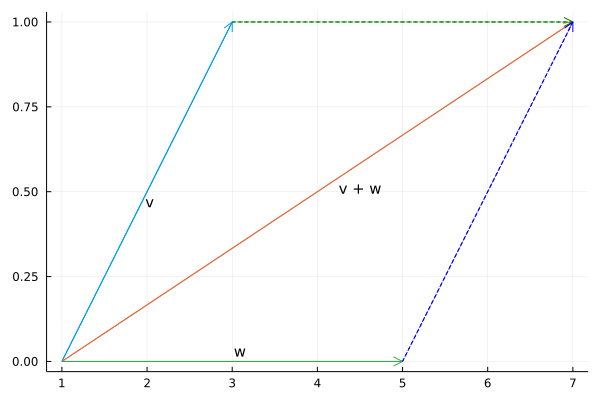

In [17]:
# Parallelogram Rule for Vector addition
using Plots, LaTeXStrings
gr()       # better arrows than plotly()

quiver([1],[0], quiver=([2],[1])) # initial at (1,0) and terminal at (3,1)
quiver!([1],[0], quiver=([6],[1])) # initial at (1,0) and terminal at (7,1)
quiver!([1],[0], quiver=([4],[0])) # initial at (1,0) and terminal at (5,0)

quiver!([3],[1], quiver=([4],[0]), linecolors=:green, linestyle=:dash) # initial at (3,1) and terminal at (7,1)
quiver!([5],[0], quiver=([2],[1]), linecolors=:blue, linestyle=:dash) # initial at (5,0) and terminal at (7,1)

a = L"$v$"

annotate!([(3.09,0.03, ("w", 10, :black)),
           (4.5,0.51, ("v + w", 10, :black)),
           (2.03,0.47, ("v", 10, :black))])


##### Triangle Rule for Vector Addition
If $\boldsymbol{v}$ and $\boldsymbol{w}$ are vectors in 2-space or 3-space that are positioned so their initial point of $\boldsymbol{w}$ is at the terminal point of $\boldsymbol{v}$, then the sum $\boldsymbol{v + w}$ is represented by the arrow from the initial point of $\boldsymbol{v}$ to the terminal point of $\boldsymbol{w}$.

The sum obtained by the triangle rule is the same as the sum obtained by the parallelogram rule.

\begin{equation}
v + w = w + v
\end{equation}

In [ ]:
# Triangle Rule for Vector addition: v + w
using Plots, LaTeXStrings
gr()       # better arrows than plotly()

quiver([1],[0], quiver=([2],[1])) # initial at (1,0) and terminal at (3,1)
quiver!([1],[0], quiver=([6],[1])) # initial at (1,0) and terminal at (7,1)

quiver!([3],[1], quiver=([4],[0])) # initial at (3,1) and terminal at (7,1)

a = L"$v$"

annotate!([(4.69,0.93, ("w", 10, :black)),
           (4.5,0.51, ("v + w", 10, :black)),
           (2.03,0.47, ("v", 10, :black))])


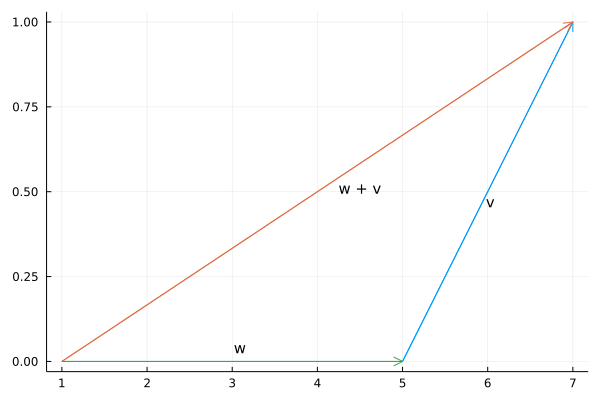

In [19]:
# Triangle Rule for Vector addition: w + v
using Plots
gr()       # better arrows than plotly()

quiver([5],[0], quiver=([2],[1])) # initial at (5,0) and terminal at (7,1)
quiver!([1],[0], quiver=([6],[1])) # initial at (1,0) and terminal at (7,1)
quiver!([1],[0], quiver=([4],[0])) # initial at (1,0) and terminal at (5,0)


annotate!([(3.09,0.04, ("w", 10, :black)),
           (4.5,0.51, ("w + v", 10, :black)),
           (6.03,0.47, ("v", 10, :black))])

┌ Info: Precompiling CalculusWithJulia [a2e0e22d-7d4c-5312-9169-8b992201a882]
└ @ Base loading.jl:1423
  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **



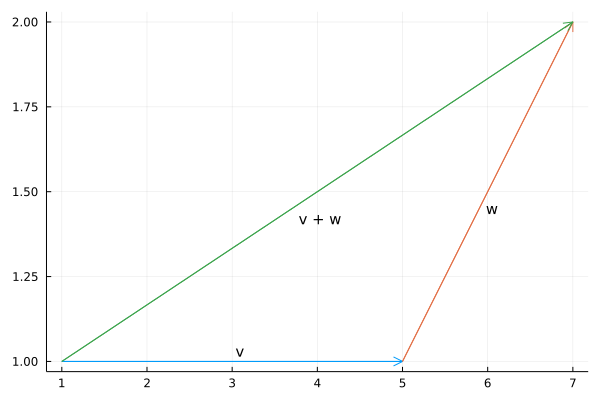

In [1]:
# Vector addition example using CalculusWithJulia
# With unzip defined, we can plot a 2-D vector v anchored at point p through quiver(unzip([p])..., quiver=unzip([v]))
# if u=[1,2,3], the unzip([u]) becomes ([1],[2],[3]). 
# And if v=[4,5,6], then unzip([u,v]) becomes ([1,4],[2,5],[3,6])

using Plots, CalculusWithJulia
gr()       # better arrows than plotly()

unzip(vs) = Tuple(eltype(first(vs))[xyz[j] for xyz in vs] for j in eachindex(first(vs)))

u = [4, 0]
v = [2, 1]
w = u + v
p = [1,1]
quiver(unzip([p])..., quiver=unzip([u])) # initial at (1,1) terminal at (5,1)
quiver!(unzip([u+p])..., quiver=unzip([v])) # initial at (5,1) terminal at (6,2)
quiver!(unzip([p])..., quiver=unzip([w])) # initial at (1,1) terminal at (6,2)

annotate!([(3.09,1.03, ("v", 10, :black)),
           (6.05,1.45, ("w", 10, :black)),
           (4.03,1.42, ("v + w", 10, :black))])

##### Vector Addition Viewed as Translation

If $\boldsymbol{v}$ and $\boldsymbol{w}$, and $\boldsymbol{v + w}$ are positioned so their initial points coincide, then the terminal point of $\boldsymbol{v + w}$ can be viewed in two ways:
1. The terminal point of $\boldsymbol{v + w}$ is the point that results when the terminal point of $\boldsymbol{v}$ is translated in the direction of $\boldsymbol{w}$ by a distance equal to the length of $\boldsymbol{w}$.
2. The terminal point of $\boldsymbol{v + w}$ is the point that results when the terminal point of $\boldsymbol{w}$ is translated in the direction of $\boldsymbol{v}$ by a distance equal to the length of $\boldsymbol{v}$.

$\boldsymbol{v + w}$ is the translation of $\boldsymbol{v}$ by $\boldsymbol{w}$ or, alternatively, the translation of $\boldsymbol{w}$ by $\boldsymbol{v}$.

#### Vector Subtraction

The negative of a vector $\boldsymbol{v}$, denoted by $\boldsymbol{-v}$, is the vector that has the same length as $\boldsymbol{v}$ but is oppositely directed, and the difference of $\boldsymbol{v}$ from $\boldsymbol{w}$, denoted by $\boldsymbol{w - v}$, is taken to be the sum

\begin{equation}
w - v = w + (-v)
\end{equation}

┌ Info: Precompiling CalculusWithJulia [a2e0e22d-7d4c-5312-9169-8b992201a882]
└ @ Base loading.jl:1423
  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **

  ** incremental compilation may be fatally broken for this module **



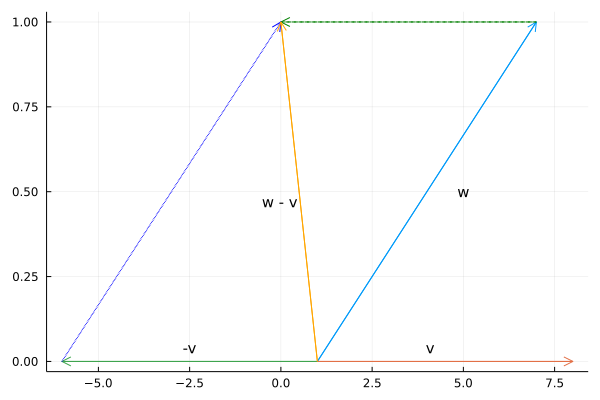

In [1]:
# Vector subtraction
using Plots, CalculusWithJulia
gr()       # better arrows than plotly()

unzip(vs) = Tuple(eltype(first(vs))[xyz[j] for xyz in vs] for j in eachindex(first(vs)))

quiver([1],[0], quiver=([6],[1])) # initial at (1,0) and terminal at (7,1)
quiver!([1],[0], quiver=([7],[0])) # initial at (1,0) and terminal at (8,0)
quiver!([1],[0], quiver=([-7],[0])) # initial at (1,0) and terminal at (-6,0)
quiver!([7],[1], quiver=([-7],[0]), linecolors=:green, linestyle=:dash) # initial at (7,1) and terminal at (0,1)

quiver!([-6],[0], quiver=([6],[1]), linecolors=:blue, linestyle=:dot) # initial at (-6,0) and terminal at (0,1)
quiver!([1],[0], quiver=([-1],[1]), linecolors=:orange) # initial at (1,0) and terminal at (0,1)

annotate!([(4.09,0.04, ("v", 10, :black)),
           (-2.5,0.04, ("-v", 10, :black)),
           (5,0.5, ("w", 10, :black)),
           (-0.03,0.47, ("w - v", 10, :black))])

#### Scalar Multiplication

If $\boldsymbol{v}$ is a nonzero vector in 2-space or 3-space, and if $k$ is a nonzero scalar, then we define the scalar product of $\boldsymbol{v}$ by $k$ to be the vector whose length is $|k|$ times the length of $\boldsymbol{v}$ and whose direction is the same as that of $\boldsymbol{v}$ if $k$ is positive and opposite to that of $\boldsymbol{v}$ if $k$ is negative. If $k = 0$ or $\boldsymbol{v = 0}$, then we define $k \boldsymbol{v}$ to be $\boldsymbol{0}$. 



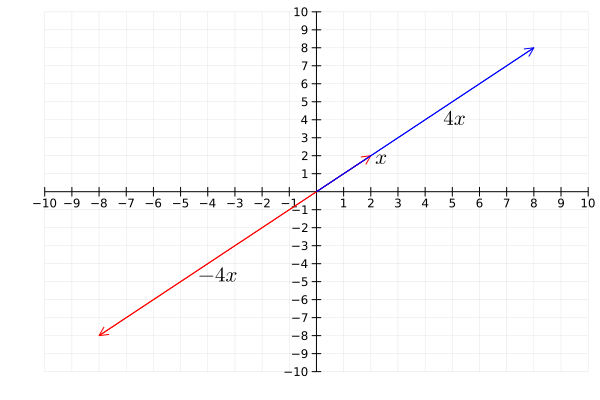

In [45]:
# Scalar multiplication

using Plots, LaTeXStrings
gr()

x = [2] # vector x=(2,2)
scalars = [-4 1 4] 
vals = [0 0 0; x * scalars]
labels = [(-3.6, -4.6, L"-4x"), (2.4, 1.8, L"x"), (5.1, 4.1, L"4x")]

plot(vals, vals, arrow = true, color = [:red :red :blue],
     legend = :none, xlims = (-10, 10), ylims = (-10, 10),
     annotations = labels, xticks = -10:1:10, yticks = -10:1:10,
     framestyle = :origin)

#### Parallel and Collinear Vectors

Suppose that $\boldsymbol{v}$ and $\boldsymbol{w}$ are vectors in 2-space or 3-space with a common initial point.

If one of the vectors is a scalar multiple of the other, then the vectors lie on a common line (collinear).

If we translate one of the vectors, then the vectors are parallel and no longer collinear.

#### Sums of Three or More Vectors

Vector addition satisfies the associative law for addition, meaning that when we add three vectors, say $\boldsymbol{u, v}$ and $\boldsymbol{w}$, it does not matter which two we add first

\begin{equation}
\boldsymbol{u + (v + w) = (u + v) + w}
\end{equation}

A simple way to construct $\boldsymbol{u + v + w}$ is to place the vectors "tip to tail" in succession then draw the vector from the initial point of $\boldsymbol{u}$ to the terminal point of $\boldsymbol{w}$.

The tip to tail method also works for four or more vectors.

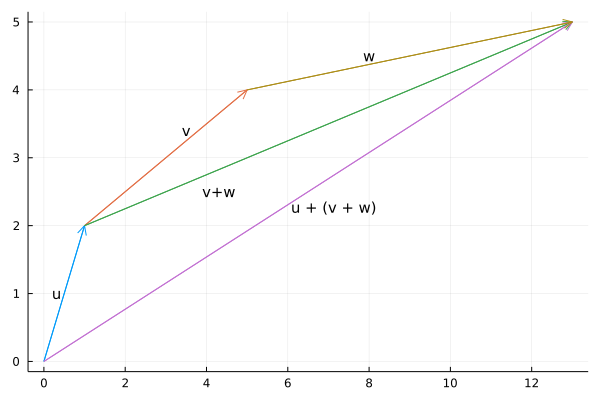

In [24]:
# Sums of Three vectors
using Plots
gr()       # better arrows than plotly()

unzip(vs) = Tuple(eltype(first(vs))[xyz[j] for xyz in vs] for j in eachindex(first(vs)))

u = [1, 2]
v = [4, 2]
w = [8,1]
vw = v + w
uvw = u + v + w
p = [0,0]


plot(legend=false)
arrow!(p, u) # Initial point at p(0,0) with terminal point at u(1,2)
arrow!(u, v) # Initial point at u(1,2) with terminal point at u+v(5,4)
arrow!(u, vw) # Initial point at u(1,2) with terminal point at vw=v+w(13,5)
arrow!(p, uvw) # Initial point at p(0,0) with terminal point at uv=u+v+w(13,5)
arrow!(uv, w) # Initial point at uv=u+v(5,4) with terminal point at w(13,5)

annotate!([(0.31,1, ("u", 10, :black)),
           (3.5,3.4, ("v", 10, :black)),
           (8,4.5, ("w", 10, :black)),
           (4.3,2.5, ("v+w", 10, :black)),
           (7.13,2.27, ("u + (v + w)", 10, :black))])

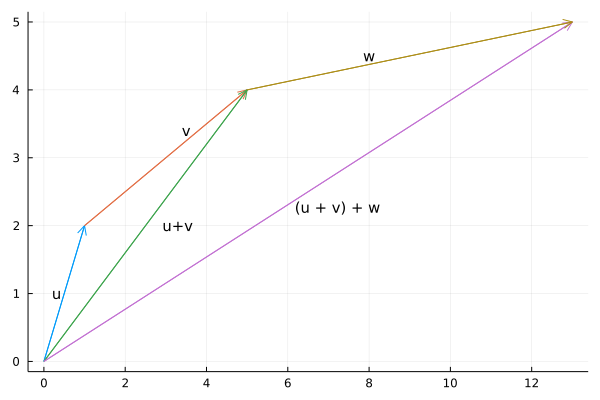

In [25]:
# Sums of Three vectors
using Plots
gr()       # better arrows than plotly()

unzip(vs) = Tuple(eltype(first(vs))[xyz[j] for xyz in vs] for j in eachindex(first(vs)))

u = [1, 2]
v = [4, 2]
w = [8,1]
uv = u + v
uvw = u + v + w
p = [0,0]


plot(legend=false)
arrow!(p, u) # Initial point at p(0,0) with terminal point at u(1,2)
arrow!(u, v) # Initial point at u(1,2) with terminal point at u+v(5,4)
arrow!(p, uv) # Initial point at p(0,0) with terminal point at uv=u+v(5,4)
arrow!(p, uvw) # Initial point at p(0,0) with terminal point at uv=u+v+w(13,5)
arrow!(uv, w) # Initial point at uv=u+v(5,4) with terminal point at w(13,5)

annotate!([(0.31,1, ("u", 10, :black)),
           (3.5,3.4, ("v", 10, :black)),
           (8,4.5, ("w", 10, :black)),
           (3.3,2, ("u+v", 10, :black)),
           (7.23,2.27, ("(u + v) + w", 10, :black))])

#### Vectors in Coordinate Systems

Computations with vectors are much simpler to perform if a coordinate system is present to work with.

If a vector $\boldsymbol{v}$ in 2-space or 3-space is positioned with its initial point at the origin of a rectangular coordinate system, then the vector is completely determined by the coordinates of its terminal point.

We call these coordinates the components of $\boldsymbol{v}$ relative to the coordinate system.

We write
\begin{equation}
\boldsymbol{v} = (v_{1}, v_{2})
\end{equation}
to denote a vector $\boldsymbol{v}$ in 2-space.

\begin{equation}
\boldsymbol{v} = (v_{1}, v_{2}, v_{3})
\end{equation}
to denote a vector $\boldsymbol{v}$ in 3-space.

The vectors
\begin{equation}
\boldsymbol{v} = (v_{1}, v_{2}, v_{3}) \quad \text{and} \quad \boldsymbol{w} = (w_{1}, w_{2}, w_{3})
\end{equation}
are equivalent in 3-space if and only if
\begin{equation}
v_{1} = w_{1}, \quad v_{2} = w_{2}, \quad v_{3} = w_{3}
\end{equation}

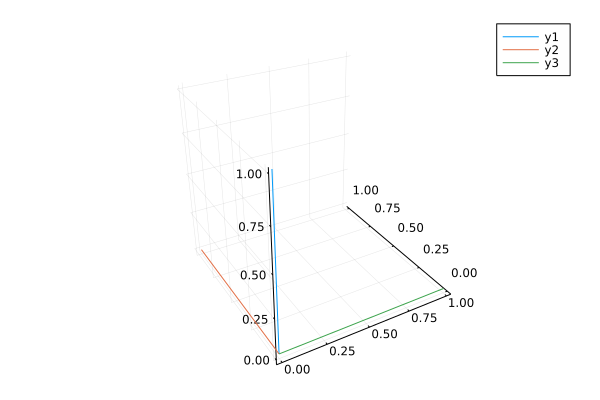

In [32]:
#Plot vectors (1,0,0), (0,1,0), and (0,0,1) in 3-d
using Plots
gr()

extract(P,V) = [ [P[1], V[1]], [P[2], V[2]], [P[3], V[3]] ]

P, xc, yc, zc = [0,0,0], [0,0,1], [0,1,0], [1,0,0]

plot(extract(P,xc)...,  st=:line, camera=(-30,30))
plot!(extract(P,yc)..., st=:line, arrow=true)
plot!(extract(P,zc)..., st=:line)


#### Vectors Whose Initial Point is Not at the Origin

Consider vectors whose initial points are not at the origin. 

$\overrightarrow{P_{1} P_{2}}$ denotes the vector with initial point $P_{1} (x_{1}, y_{1})$ and terminal point $P_{2} (x_{2}, y_{2})$, then the component of this vector are given by the formula

\begin{equation}
\overrightarrow{P_{1} P_{2}} = (x_{2} - x_{1}, y_{2} - y_{1})
\end{equation}

The components of a vector in 3-space that has initial point $P_{1} (x_{1}, y_{1}, z_{1})$ and terminal point $P_{2} (x_{2}, y_{2}, z_{2})$ are given by

\begin{equation}
\overrightarrow{P_{1} P_{2}} = (x_{2} - x_{1}, y_{2} - y_{1}, z_{2} - z_{1})
\end{equation}


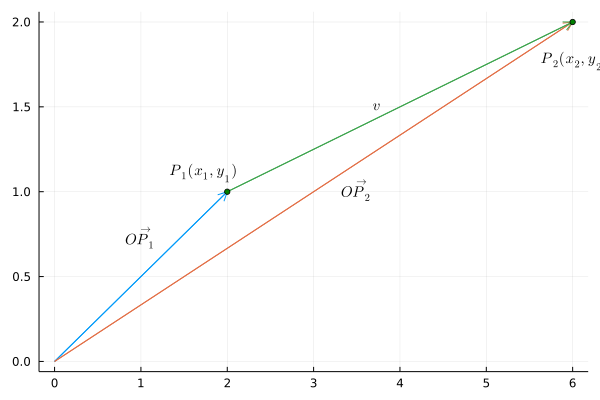

In [30]:
# Vector with initial point is not at the Origin
using Plots, LaTeXStrings
gr()       # better arrows than plotly()

quiver([0],[0], quiver=([2],[1])) # initial at (0,0) and terminal at (2,1)
quiver!([0],[0], quiver=([6],[2])) # initial at (0,0) and terminal at (6,2)
quiver!([2],[1], quiver=([4],[1])) # initial at (2,1) and terminal at (6,2)

scatter!([2], [1], color = "green", label="", markersize = 3)
scatter!([6], [2], color = "green", label="", markersize = 3)

annotate!([(1,0.73, (L"\overrightarrow{OP_{1}}", 10, :black)),
           (3.5,1.01, (L"\overrightarrow{OP_{2}}", 10, :black)),
           (3.73,1.5, (L"v", 10, :black)),
           (6.03,1.77, (L"P_{2}(x_{2},y_{2})", 10, :black)),
           (1.73,1.11, (L"P_{1}(x_{1},y_{1})", 10, :black))])

#### $n$-Space

By the dawn of the twentieth century, mathematicians and physicists were exploring the use of "higher-dimensional" spaces in mathematics and physics.

The notion of using time as a fourth dimension is an idea used by Albert Einstein in developing the general theory of relativity.

The set of all real numbers can be viewed geometrically as a line. It is called the real line and is denoted by $\mathbb{R}$ or $\mathbb{R}^{1}$.

The set of all ordered pairs of real numbers (2-tuples) is denoted by $\mathbb{R}^{2}$. Correspond to points in the plane.

The set of all ordered triples of real numbers (3-tuples) is denoted by $\mathbb{R}^{3}$. Correspond to points in space.

If $n$ is a positive integer, then an ordered-$n$-tuple is a sequence of $n$ real numbers ($v_{1}, v_{2}, \dots, v_{n}$). The set of all ordered $n$-tuples is called $n$-space and is denoted by $\mathbb{R}^{n}$

#### Operations on Vectors in $\mathbb{R}^{n}$

We will denote a vector $\boldsymbol{v}$ in $\mathbb{R}^{n}$ using the notation
\begin{equation}
\boldsymbol{v} = (v_{1}, v_{2}, \dots, v_{n})
\end{equation}
and we will call $\boldsymbol{0} = (0, 0, \dots, 0)$ the zero vector.

Vectors $\boldsymbol{v} = (v_{1}, v_{2}, \dots, v_{n})$ and $\boldsymbol{w} = (w_{1}, w_{2}, \dots, w_{n})$ in $\mathbb{R}^{n}$ are said to be equivalent if
\begin{equation}
 v_{1} = w_{1}, \quad v_{2} = w_{2}, \dots, \quad  v_{n} = w_{n}
\end{equation}
We indicate this by writing $\boldsymbol{v = w}$.

If $\boldsymbol{v} = (v_{1}, v_{2}, \dots, v_{n})$ and $\boldsymbol{w} = (w_{1}, w_{2}, \dots, w_{n})$ are vectors in $\mathbb{R}^{n}$, and if $k$ is any scalar, then we define
\begin{equation}
\begin{matrix}
\boldsymbol{v + w} & = & (v_{1} + w_{1}, v_{2} + w_{2}, \dots, v_{n} + w_{n})\\
k \boldsymbol{v} & = & (kv_{1}, kv_{2}, \dots, kv_{n})\\
\boldsymbol{-v} & = & (-v_{1}, -v_{2}, \dots, -v_{n})\\
\boldsymbol{w - v = w + (-v)} & = & (w_{1} - v_{1}, w_{2} - v_{2}, \dots, w_{n} - v_{n})\\
\end{matrix}
\end{equation}

If $\boldsymbol{u, v}$ and $\boldsymbol{w}$ are vectors in $\mathbb{R}^{n}$, and if $k$ and $m$ are scalars, then:

(a) $\boldsymbol{u + v = v + u}$

(b) $\boldsymbol{(u + v) + w = u + (v + w)}$

(c) $\boldsymbol{u + 0 = 0 + u = u}$

(d) $\boldsymbol{u + (-u) = 0}$

(e) k$\boldsymbol{(u + v)}$ = k$\boldsymbol{u}$ + k$\boldsymbol{v}$

(f) (k + m)$\boldsymbol{u}$ = k$\boldsymbol{u}$ + m$\boldsymbol{u}$

(g) k(m$\boldsymbol{u}$) = (km)$\boldsymbol{u}$ 

(h) 1$\boldsymbol{u}$ = $\boldsymbol{u}$



If $\boldsymbol{v}$ is a vector in $\mathbb{R}^{n}$ and $k$ is a scalar, then:

(a) 0$\boldsymbol{v = 0}$

(b) k$\boldsymbol{0 = 0}$

(c) (-1)$\boldsymbol{v = -v}$

#### Calculating Without Components

Suppose that $\boldsymbol{x, a}$, and $\boldsymbol{b}$ are vectors in $\mathbb{R^{n}}$, and we want to solve the vector equation $\boldsymbol{x + a = b}$ for the vector $\boldsymbol{x}$ without using components. We could proceed as follows:
\begin{equation}
\boldsymbol{x + a = b} \\
\boldsymbol{(x + a) + (-a) = b + (-a)} \\
\boldsymbol{x + (a + (-a)) = b - a} \\
\boldsymbol{x + 0 = b - a} \\
\boldsymbol{x = b - a} \\
\end{equation}

#### Linear Combinations

Addition, subtraction, and scalar multiplication are frequently used in combination to form new vectors.

If $\boldsymbol{v_{1}, v_{2}}$, and $\boldsymbol{v_{3}}$ are vectors in $\mathbb{R^{n}}$, then the vectors
\begin{equation}
\boldsymbol{u} = 2\boldsymbol{v_{1}} + 3\boldsymbol{v_{2} + v_{3}} \quad \text{and} \quad \boldsymbol{w} = 7\boldsymbol{v_{1}} - 6 \boldsymbol{v_{2}} + 8 \boldsymbol{v_{3}}
\end{equation}
are formed in this way.

If $\boldsymbol{w}$ is a vector in $\mathbb{R^{n}}$, then $\boldsymbol{w}$ is said to be a linear combination of the vectors $\boldsymbol{v_{1}, v_{2}, \dots, v_{r}}$ in $\mathbb{R^{n}}$ if it can be expressed in the form

\begin{equation}
\boldsymbol{w} = k_{1}\boldsymbol{v_{1}} + k_{2}\boldsymbol{v_{2}} + \dots + k_{r}\boldsymbol{v_{r}}
\end{equation}

where $k_{1}, k_{2}, \dots, k_{r}$ are scalars.

##### Exercise no 26 chapter 3.1
Find all scalars $c_{1}, c_{2}$, and $c_{3}$ such that
$c_{1}(1,2,0) + c_{2}(2,1,1) + c_{3}(0,3,1) =(0,0,0)$

In [5]:
using Symbolics, LinearAlgebraX

@variables b1 b2 b3

A = [1 2 0 b1
     2 1 3 b2
     0 1 1 b3]

rrefx(A)

3×4 Matrix{Num}:
 1.0  0.0  0.0  0.333333b1 + 0.333333b2 - b3
 0.0  1.0  0.0  0.333333b1 + 0.5b3 - 0.166667b2
 0.0  0.0  1.0  0.166667b2 + 0.5b3 - 0.333333b1

##### Exercise no 27 chapter 3.1
Find all scalars $c_{1}, c_{2}$, and $c_{3}$ such that
$c_{1}(1,-1,0) + c_{2}(3,2,1) + c_{3}(0,1,4) =(-1,1,19)$

In [10]:
using LinearAlgebraX

A = [1 3 0 -1
     -1 2 1 1
     0 1 4 19]

Float64.(rrefx(A))

3×4 Matrix{Float64}:
 1.0  0.0  0.0   2.0
 0.0  1.0  0.0  -1.0
 0.0  0.0  1.0   5.0

#### Alternative Notations for Vectors

We have been writing vectors in $\mathbb{R^{n}}$ using the notation
\begin{equation}
\boldsymbol{v} = (v_{1}, v_{2}, \dots, v_{n})
\end{equation}
We call this the comma-delimited form.

Vector can also be written as
\begin{equation}
\boldsymbol{v} = [v_{1} \ v_{2} \ \dots \ v_{n}]
\end{equation}

which is called row-matrix form, or as
\begin{equation}
\boldsymbol{v} = 
\begin{bmatrix}
v_{1} \\
v_{2} \\ 
\vdots \\
v_{n}
\end{bmatrix}
\end{equation}
which is called column-matrix form.

## 3.2. Norm, Dot Product, and Distance in $R^{n}$

#### Norm of a Vector

We will denote the length of a vector $\boldsymbol{v}$ by the symbol $||\boldsymbol{v}||$. From the Theorem of Pythagoras the norm of a vector ($v_{1}, v_{2}$) in $\mathbb{R^{2}}$ is
\begin{equation}
||\boldsymbol{v}||= \sqrt{v_{1}^{2} + v_{2}^{2} }
\end{equation}

Similarly for a vector ($v_{1}, v_{2}, v_{3}$) in $\mathbb{R^{3}}$, the norm is
\begin{equation}
||\boldsymbol{v}||= \sqrt{v_{1}^{2} + v_{2}^{2} + v_{3}^{2}}
\end{equation}

If $\boldsymbol{v} = (v_{1}, v_{1}, \dots, v_{n})$ is a vector $\mathbb{R^{n}}$, then the norm of $\boldsymbol{v}$ is denoted by $||\boldsymbol{v}||$, and is defined by the formula

\begin{equation}
||\boldsymbol{v}||= \sqrt{v_{1}^{2} + v_{2}^{2} + v_{3}^{2} + \dots + v_{n}^{2}}
\end{equation}

Three familiar facts about vectors in $\mathbb{R^{2}}$ and $\mathbb{R^{3}}$:

* Distances are nonnegative
* The zero vector is the only vector of length zero
* Multiplying a vector by a scalar multiplies its length by the absolute value of that scalar

If $\boldsymbol{v}$ is a vector in in $\mathbb{R^{n}}$, and if $k$ is any scalar, then

(a) $||\boldsymbol{v}|| \ge 0$

(b) $||\boldsymbol{v}|| = 0 \ \text{if and only if} \ \boldsymbol{v = 0}$

(c) $||k\boldsymbol{v}|| = |k|||\boldsymbol{v}||$

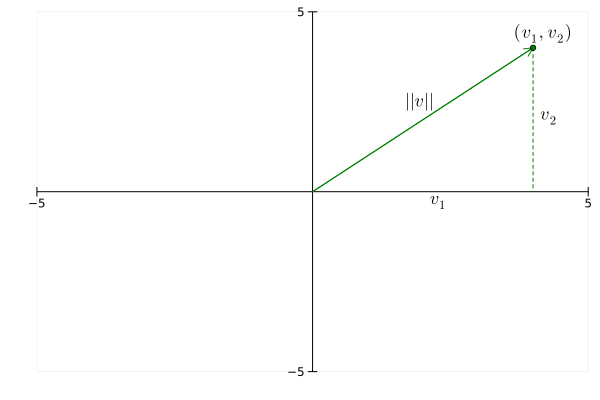

In [37]:
# Plot norm of a vector in 2-d
using LaTeXStrings, LinearAlgebra, Statistics, Plots
gr()

x_vals = [0 ; 4 ]
y_vals = [0 ; 4 ]

plot(x_vals, y_vals, arrow = true, color = :green,
     legend = :none, xlims = (-5, 5), ylims = (-5, 5),
     annotations = [(4.2, 4.4, (L"(v_{1}, v_{2})", 12)),
                    (2, 2.5, (L"||v||", 12)),
                    (2.3, -0.3, (L"v_{1}", 12)),
                    (4.3, 2.05, (L"v_{2}", 12))],
     xticks = -5:5:5, yticks = -5:5:5,
     framestyle = :origin)

plot!([4,4],[4,0], linecolor=:green, linestyle=:dash)
scatter!([4], [4], color = "green", label="", markersize = 3)

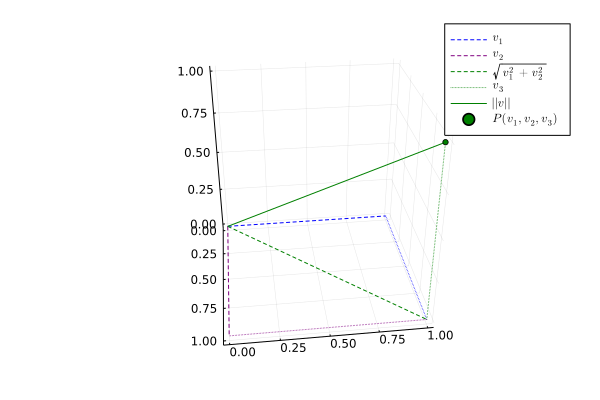

In [7]:
# Plot norm of a vector in 3-d
using Plots, LaTeXStrings
gr()

extract(P,V) = [ [P[1], V[1]], [P[2], V[2]], [P[3], V[3]] ]

P, xc, yc, xyc, dc = [0,0,0], [0,1,0], [1,0,0], [1,1,0], [1,1,1]

plot(extract(P,xc)...,  st=:line,  label=L"v_{1}", linecolor=:blue, linestyle=:dash, camera=(83,30))
plot!(extract(P,yc)..., st=:line, label=L"v_{2}", linecolor=:purple, linestyle=:dash, arrow=true)
plot!(extract(P,xyc)..., st=:line, label=L"\sqrt{v_{1}^{2} + v_{2}^{2}}", linecolor=:green, linestyle=:dash)
plot!(extract(xyc,xc)..., st=:line, label="", linecolor=:blue, linestyle=:dot)
plot!(extract(xyc,yc)..., st=:line, label="", linecolor=:purple, linestyle=:dot)
plot!(extract(xyc,dc)..., st=:line, label=L"v_{3}", linecolor=:green, linestyle=:dot)
plot!(extract(P,dc)..., st=:line, label=L"||v||", linecolor=:green)

#The following workaround seems to allow the text to be displayed on a 2D canvas over the 3D plot. 
# But we have to manually adjust the coordinates until we are satisfied:
#plot!([1.01], [0.87], [NaN], text=L"\pi/2")'

scatter!([1], [1], [1], color = "green", label=L"P(v_{1},v_{2},v_{3})", markersize = 3)

#### Unit Vectors

A vector of norm 1 is called a unit vector.

If $\boldsymbol{v}$ is any nonzero vector in $\mathbb{R^{n}}$, then

\begin{equation}
\boldsymbol{u} = \frac{1}{||\boldsymbol{v}||}\boldsymbol{v}
\end{equation}
is a unit vector with the same direction as $\boldsymbol{v}$.

The process of multiplying a nonzero vector by the reciprocal of its length to obtain a unit vector is called normalizing $\boldsymbol{v}$.

##### Example Normalizing a vector
Find unit vector $\boldsymbol{u}$ that has the same direction as $\boldsymbol{v} = (2,2,-1)$

The vector $\boldsymbol{v}$ has length
\begin{equation}
    ||\boldsymbol{v}|| = \sqrt{2^{2} + 2^{2} + (-1)^{2}} = 3
\end{equation}

Thus,

\begin{equation}
    \boldsymbol{u} = \frac{1}{3}(2, 2, -1) =
    \begin{pmatrix}
    \frac{2}{3},\frac{2}{3},\frac{-1}{3}
    \end{pmatrix}
\end{equation}

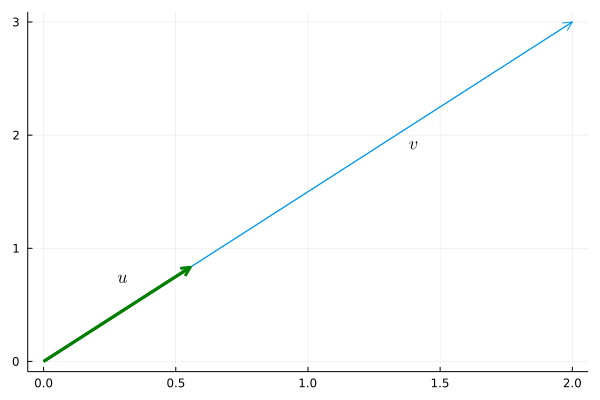

In [7]:
# Normalizing a vector (find unit vector u that has the same direction as v)
using Plots, LinearAlgebra, LaTeXStrings
v = [2, 3]
u = v / norm(v)
p = [0, 0]
plot(legend=false)
arrow!(p, v)
arrow!(p, u, linewidth=3, linecolor=:green)

annotate!([(0.3,0.73, (L"u", 12, :black)),
           (1.4,1.91, (L"v", 12, :black))])

#### The Standard Unit Vectors

When a rectangular coordinate system is introduced in $\mathbb{R^{2}}$ or $\mathbb{R^{3}}$, the unit vectors in the positive directions of the coordinate axes are called the standard unit vectors. 

In $\mathbb{R^{2}}$ these vectors are denoted by
\begin{equation}
\boldsymbol{i} = (1, 0) \quad \text{and} \quad \boldsymbol{j} = (0, 1)
\end{equation}

and in $\mathbb{R^{3}}$ by
\begin{equation}
\boldsymbol{i} = (1, 0, 0), \quad \boldsymbol{j} = (0, 1, 0), \quad \text{and} \quad \boldsymbol{k} = (0, 0, 1)
\end{equation}

Every vector $\boldsymbol{v} = (v_{1}, v_{2})$ in $\mathbb{R^{2}}$ and every vector $\boldsymbol{v} = (v_{1}, v_{2}, v_{3})$ in $\mathbb{R^{3}}$ can be expressed as a linear combination of standard unit vectors by writing

\begin{equation}
\boldsymbol{v} = (v_{1}, v_{2}) = v_{1}(1, 0) + v_{2}(0, 1) = v_{1}\boldsymbol{i} + v_{2}\boldsymbol{j} \\
\boldsymbol{v} = (v_{1}, v_{2}, v_{3}) = v_{1}(1, 0, 0) + v_{2}(0, 1, 0) + v_{3}(0, 0, 1) = v_{1}\boldsymbol{i} + v_{2}\boldsymbol{j} + v_{3}\boldsymbol{k}
\end{equation}

We can generalize these formulas to $\mathbb{R^{n}}$ by defining the standard unit vectors in $\mathbb{R^{n}}$ to be
\begin{equation}
\boldsymbol{e_{i}} = (1, 0, 0, \dots, 0), \quad \boldsymbol{e_{2}} = (0, 1, 0, \dots, 0), \dots, \quad \boldsymbol{e_{n}} = (0, 0, 0, \dots, 1)
\end{equation}

Every vector $\boldsymbol{v} = (v_{1}, v_{2}, \dots, v_{n})$ in $\mathbb{R^{n}}$ can be expressed as

\begin{equation}
\boldsymbol{v} = (v_{1}, v_{2}, \dots, v_{n}) = v_{1}\boldsymbol{e_{1}} + v_{2}\boldsymbol{e_{2}} + \dots + v_{n}\boldsymbol{e_{n}}
\end{equation}

Linear combinations of Standard Unit Vectors
\begin{equation}
(2, -3, 4) = 2\boldsymbol{i} - 3\boldsymbol{j} + 4\boldsymbol{k} \\
(7, 3, -4, 5) = 7\boldsymbol{e_{1}} + 3\boldsymbol{e_{2}} - 4\boldsymbol{e_{3}} + 5\boldsymbol{e_{4}} \\
\end{equation}

#### Distance in $\mathbb{R^{n}}$

If $P_{1}$ and $P_{2}$ are points in $\mathbb{R^{2}}$ or $\mathbb{R^{3}}$, then the length of the vector $\overrightarrow{P_{1}P_{2}}$ is equal to the distance $d$ between the two points.

\begin{equation}
d = ||\overrightarrow{P_{1} P_{2}}|| = \sqrt{(x_{2} - x_{1})^{2} + (y_{2} - y_{1})^{2}}
\end{equation}

The distance between the points $P_{1} (x_{1}, y_{1}, z_{1})$ and $P_{2} (x_{2}, y_{2}, z_{2})$ in 3-space is

\begin{equation}
d(\boldsymbol{u,v}) = ||\overrightarrow{P_{1} P_{2}}|| = \sqrt{(x_{2} - x_{1})^{2} + (y_{2} - y_{1})^{2} + (z_{2} - z_{1})^{2}}
\end{equation}

If $\boldsymbol{u} = (u_{1}, u_{2}, \dots, u_{n})$ and $\boldsymbol{v} = (v_{1}, v_{2}, \dots, u_{n})$ are points in $\mathbb{R^{n}}$, then we denote the distance between $\boldsymbol{u}$ and $\boldsymbol{v}$ by $d(\boldsymbol{u,v})$ and define it to be

\begin{equation}
d(\boldsymbol{u,v}) = ||\boldsymbol{u - v}|| = \sqrt{(u_{1} - v_{1})^{2} + (u_{2} - v_{2})^{2} + \dots + (u_{n} - v_{n})^{2}}
\end{equation}

In [5]:
using Distances

u = [1,3,-2,7]
v = [0,7,2,2]

d = euclidean(u, v)

7.615773105863909

#### Dot Product

We define the angle between $\boldsymbol{u}$ and $\boldsymbol{v}$ to be the angle $\theta$ determined by $\boldsymbol{u}$ and $\boldsymbol{v}$ that satisfies the inequalitites $ 0 \le \theta \le \pi$

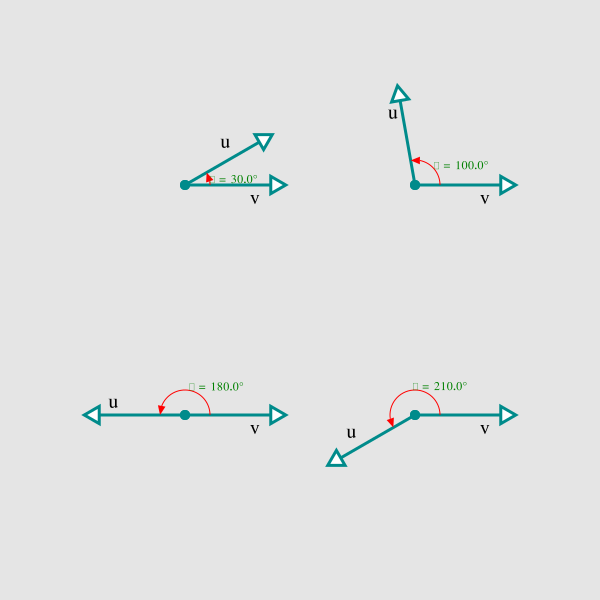

In [6]:
using Luxor

function vector(pt1, pt2)
    arrow(pt1, pt2,
        arrowheadfunction=(s, e, sl) -> begin
            @layer begin
                translate(s)
                rotate(sl)
                @layer begin
                    sethue("white")
                    ngon(O, 10, 3, 0, :fillpreserve)
                end
                strokepath()
            end
        end,
        linewidth=3)
    circle(pt1, 5, :fill)
end

function draw_vector_angle(r, θ)
    p₁ = Point(0, 0)
    p₂ = polar(r, 0)
    p₃ = Point(r * cos(θ), r * sin(θ))
    sethue("darkcyan")
    vector(p₁, p₂)
    vector(p₁, p₃)
    sethue("red")

    arrow(O, r / 4, 0, θ,
        clockwise=false,
        decoration=0.5,
        decorate=() -> begin
            sethue("green")
            fontsize(12)
            rotate(-getrotation())
            text("θ = " * string(round(rad2deg(anglethreepoints(p₂, p₁, p₃)), digits=1)) * "°")
        end)
    sethue("black")
    fontsize(20)
    fontface("NewCM10-Bold")
    label("v", :s, between(p₁, p₂, 0.7), offset=10)
    label("u", :nw, between(p₁, p₃, 0.6), offset=10)
end

@drawsvg begin
    background("grey90")
    tiles = Tiler(600, 600, 2, 2, margin=70)
    r = 100
    angles = deg2rad.([-30, -100, 180, -210])
    for (pos, n) in tiles
        @layer begin
            translate(pos)
            draw_vector_angle(r, angles[n])
        end
    end
end


In [ ]:
using PyCall

plt = pyimport("matplotlib.pyplot")
x = range(0;stop=2*pi,length=1000); y = sin.(3*x + 4*cos.(2*x));
plt.plot(x, y, color="red", linewidth=2.0, linestyle="--")
plt.show()

If $\boldsymbol{u}$ and $\boldsymbol{v}$ are nonzero vectors in $\mathbb{R^{2}}$ or $\mathbb{R^{3}}$, and if $\theta$ is the angle between $\boldsymbol{u}$ and $\boldsymbol{v}$, then the dot product (Euclidean inner product) of $\boldsymbol{u}$ and $\boldsymbol{v}$ is denoted by $\boldsymbol{u \cdot v}$ and is defined as

\begin{equation}
\boldsymbol{u \cdot v} = \boldsymbol{||u||||v||} \cos\theta
\end{equation}

If $\boldsymbol{u = 0}$ or $\boldsymbol{v = 0}$, then we define $\boldsymbol{u \cdot v}$ to be 0.

\begin{equation}
\cos\theta = \frac{\boldsymbol{u \cdot v}}{\boldsymbol{||u||||v||}} 
\end{equation}

Since $ 0 \le \theta \le \pi$, it follows from properties of the cosine function studied in trigonometry that
* $\theta$ is acute if $\boldsymbol{u \cdot v} > 0$
* $\theta$ is obtuse if $\boldsymbol{u \cdot v} < 0$
* $\theta = \pi/2$ if $\boldsymbol{u \cdot v} = 0$


##### Example: A Geometry Problem 

Find the angle between a diagonal of a cube and one of its edges.

Let $k$ be the length of an edge and introduce a coordinate system as: $\boldsymbol{u_{1}} = (k, 0, 0)$, $\boldsymbol{u_{2}} = (0, k, 0)$, and $\boldsymbol{u_{3}} = (0, 0, k)$, then the vector

\begin{equation}
\boldsymbol{d} = (k, k, k) = \boldsymbol{u_{1}} + \boldsymbol{u_{2}} + \boldsymbol{u_{3}} 
\end{equation}

is a diagonal of the cube. It follows that the angle $\theta$ between $\boldsymbol{d}$ and the edge $\boldsymbol{u_{1}}$ satisfies

\begin{equation}
\cos\theta = \frac{\boldsymbol{u_{1} \cdot d}}{\boldsymbol{||u_{1}||||d||}} = \frac{k^{2}}{(k)(\sqrt{3k^{2}})} = \frac{1}{\sqrt{3}}
\end{equation}

Thus,
\begin{equation}
\theta = \cos^{-1}\frac{1}{\sqrt{3}} \approx 54.74^{0}
\end{equation}

#### Component Form of the Dot Product

If $\boldsymbol{u} = (u_{1}, u_{2}, \dots, u_{n})$ and $\boldsymbol{v} = (v_{1}, v_{2}, \dots, v_{n})$ are vectors in $\mathbb{R^{n}}$, then the dot product of $\boldsymbol{u}$ and $\boldsymbol{v}$ is denoted by $\boldsymbol{u \cdot v}$ and is defined by

\begin{equation}
\boldsymbol{u \cdot v} = u_{1}v_{1} + u_{2}v_{2} + \dots + u_{n}v_{n}
\end{equation}

In [1]:
using LinearAlgebra

u = [-1, 3, 5, 7]
v = [-3, -4, 1, 0]

dot(u, v)

-4

In [ ]:
using PyCall

plt = pyimport("matplotlib.pyplot")
from matplotlib.patches import Arc
from matplotlib.lines import Line2D
import math

sim_score =[0.993832,0.543218,0.234745 ,0.873513,0.234565,0.789212]

def get_angle_text(angle_plot):
    angle = angle_plot.get_label()[:-1]  # Excluding the degree symbol
    angle = "%0.2f" % float(angle) + u"\u00b0"  # Display angle upto 2 decimal places

    # Set the label position
    x_width = angle_plot.width / 2
    y_width = math.sin(math.radians(angle_plot.theta2))

    return [x_width, y_width, angle]

def get_angle_plot(line1, offset=1, color=None, origin=[0, 0], len_x_axis=1, len_y_axis=1):

    l1xy = line1.get_xydata()

    # Angle between line1 and x-axis
    slope = (l1xy[1][1] - l1xy[0][1]) / float(l1xy[1][0] - l1xy[0][0])
    angle = abs(math.degrees(math.atan(slope)))  # Taking only the positive angle

    if color is None:
        color = line1.get_color()  # Uses the color of line 1 if color parameter is not passed.

    return Arc(origin, len_x_axis * offset, len_y_axis * offset, 0, 0, angle, color=color,
               label=str(angle) + u"\u00b0")

    sim_score = [0.993832, 0.543218, 0.234745, 0.873513]

fig = plt.figure()
ax = fig.add_subplot(111)
offset = 0
for i in sim_score:
    offset += 2  # you play with this value to draw arc spaced from the previous
    a = math.acos(i)
    b = a * 180 / math.pi
    point = (0, 0)
    x, y = point
    length = 10
    # find the end point
    endy = length * math.sin(math.radians(b))
    endx = length * math.cos(math.radians(b))

    line = Line2D([x, endx], [y, endy], linewidth=1, linestyle="-", color="blue")
    angle_plot = get_angle_plot(line, offset)
    angle_text = get_angle_text(angle_plot)
    ax.add_line(line )
    ax.add_patch(angle_plot)
    ax.text(*angle_text)  # To display the angle value

ax.set_ylim([0, 10])
ax.set_xlim([0, 10])
plt.show()


#### Algebraic Properties of the Dot Product

In the special case where $\boldsymbol{u = v}$, we obtain the relationship

\begin{equation}
\boldsymbol{v \cdot v} = v_{1}^{2} + v_{2}^{2} + \dots + v_{n}^{2} = ||\boldsymbol{v}||^{2} \\
||\boldsymbol{v}|| = \sqrt{\boldsymbol{v \cdot v}}
\end{equation}

If $\boldsymbol{u, v}$, and $\boldsymbol{w}$ are vectors in $\mathbb{R^{n}}$, and if $k$ is a scalar, then

(a) $\boldsymbol{u \cdot v = v \cdot u}$

(b) $\boldsymbol{u \cdot (v + w) = u \cdot v + u \cdot w}$

(c) $k\boldsymbol{u \cdot v =}$$(k\boldsymbol{v) \cdot v}$

(d) $\boldsymbol{v \cdot v \ge 0}$ and $\boldsymbol{v \cdot v} = 0$ if and only if $\boldsymbol{v = 0}$


Additional properties of dot products:

(a) $\boldsymbol{0 \cdot v = v \cdot 0} = 0$

(b) $\boldsymbol{(u + v) \cdot w = u \cdot w + v \cdot w}$

(c) $\boldsymbol{u \cdot (v - w) = u \cdot v - u \cdot w}$

(d) $\boldsymbol{(u - v) \cdot w = u \cdot w - v \cdot w}$

(e) $k\boldsymbol{(u \cdot v) = u \cdot}$$(k\boldsymbol{v)}$

#### Cauchy-Schwarz Inequality and Angles in $\mathbb{R^{n}}$

The next objective is to extend to $\mathbb{R^{n}}$ the notion "angle" between nonzero vectors $\boldsymbol{u}$ and $\boldsymbol{v}$.

The formula derived for nonzero vectors in $\mathbb{R^{2}}$ and $\mathbb{R^{3}}$:
\begin{equation}
\theta = \cos^{-1} 
\begin{pmatrix}
\frac{\boldsymbol{u \cdot v}}{\boldsymbol{||u||||v||}} 
\end{pmatrix}
\end{equation}

The inverse of cosine has the upper and lower bound of 1 and -1 respectively, thus
\begin{equation}
-1 \le \frac{\boldsymbol{u \cdot v}}{\boldsymbol{||u||||v||}} \le 1
\end{equation}

If $\boldsymbol{u} = (u_{1}, u_{2}, \dots, u_{n})$ and $\boldsymbol{v} = (v_{1}, v_{2}, \dots, v_{n})$ are vectors in $\mathbb{R^{n}}$, then
\begin{equation}
|\boldsymbol{u \cdot v}| \le ||\boldsymbol{u}|| ||\boldsymbol{v}||
\end{equation}

or in terms of components

\begin{equation}
|u_{1}v_{1} + u_{2}v_{2} + \dots + u_{n}v_{n}| \le (u_{1}^{2} + u_{2}^{2} + \dots + u_{n}^{2})^{1/2} (v_{1}^{2} + v_{2}^{2} + \dots + v_{n}^{2})^{1/2} 
\end{equation}

#### Geometry in $\mathbb{R^{n}}$

Two fundamental theorems from plane geometry whose validity extends to $\mathbb{R^{n}}$:

* The sum of the lengths of two side of a triangle is at least as large as the third
* The shortest distance between two points is a straight line

If $\boldsymbol{u, v}$, and $\boldsymbol{w}$ are vectors in $\mathbb{R^{n}}$, and if $k$ is any scalar, then:

(a) $\boldsymbol{||u + v|| \le ||u|| + ||v||}$

(b) $d\boldsymbol{(u, v)} \le$ $d\boldsymbol{(u, w)} +$ $d\boldsymbol{(w, v)}$

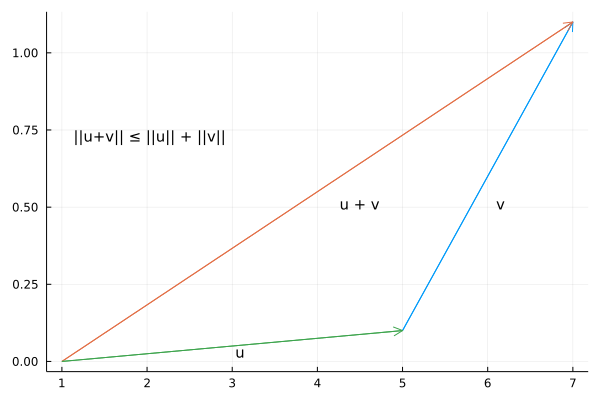

In [34]:
# Triangle inequality for vectors
using Plots, LaTeXStrings
gr()       # better arrows than plotly()

quiver([5],[0.1], quiver=([2],[1])) # initial at (5,0.1) and terminal at (7,1.1)
quiver!([1],[0], quiver=([6],[1.1])) # initial at (1,0) and terminal at (7,1.1)
quiver!([1],[0], quiver=([4],[0.1])) # initial at (1,0) and terminal at (5,0.1)

annotate!([(3.09,0.03, ("u", 10, :black)),
           (4.5,0.51, ("u + v", 10, :black)),
           (6.15,0.51, ("v", 10, :black)),
           (2.03,0.73, ("||u+v|| ≤ ||u|| + ||v||", 10, :black))])

##### Example 27 Chapter 3.2

In [ ]:
# Example 28 Chapter 3.2

##### Example 28 Chapter 3.2

In [ ]:
# Example 28 Chapter 3.2

##### True or False Exercises

(a) If each component of a vector in $\mathbb{R^{3}}$ is doubled, the norm of that vector is doubled.

(b) In $\mathbb{R^{2}}$, the vectors of norm 5 whose initial points are at the origin have terminal points lying on a circle of radius 5 centered at the origin.

(c) Every vector in $\mathbb{R^{n}}$ has a positive norm

(d) If $\boldsymbol{v}$ is a nonzero vector in $\mathbb{R^{n}}$, there are exactly two unit vectors that are parallel to $\boldsymbol{v}$

(e) If $\boldsymbol{||u||} = 2, \boldsymbol{||v||} = 1$, and $\boldsymbol{u \cdot v} = 1$, then the angle between $\boldsymbol{u}$ and $\boldsymbol{v}$ is $\pi/3$ radians.

(f) The expressions ($\boldsymbol{u \cdot v + w}$) and $\boldsymbol{u \cdot (v + w)}$ are both meaningful and equal to each other.

(g) If $\boldsymbol{u \cdot v = u \cdot w}$, then $\boldsymbol{v = w}$

(h) If $\boldsymbol{u \cdot v} = 0$, then either $\boldsymbol{u = 0}$ or $\boldsymbol{v = 0}$

(i) In $\mathbb{R^{2}}$, if $\boldsymbol{u}$ lies in the first quadrant and $\boldsymbol{v}$ lies in the third quadrant, then $\boldsymbol{u \cdot v}$ cannot be positive

(j) For all vectors $\boldsymbol{u, v}$, and $\boldsymbol{w}$ in $\mathbb{R^{n}}$, we have

\begin{equation}
||\boldsymbol{u + v + w}|| ≤ ||\boldsymbol{u}|| + ||\boldsymbol{v}|| + ||\boldsymbol{w}||
\end{equation}

## 3.3. Orthogonality

## 3.4. The Geometry of Linear Systems

## 3.5. Cross Product

# 10. Applications of Linear Algebra

## 10.1 Constructing Curves and Surfaces Through Specified Points

## 10.13 Fractals

In [6]:
# Source: https://wildpeaches.xyz/blog/julia-sets-in-julia/

using Plots, LinearAlgebra
gr()

"""
    plotIterates
Plots iteratations of the Julia function from in initial point z₀ ∈ ℂ and parameter c
    
Parameters
    z₀: Starting point
    c:  Control parameter
    n:  Number of iteratations
    
Returns
    Plot of n iteratations
"""
function plotIterates(z₀,c,n)
    # Initialize trajectory
    zₙ = length(z₀)
    traj = zeros(ComplexF64,n,zₙ)
    traj[1,:] .= z₀
    
    # Generate trajectory
    for k = 1:zₙ
        for j = 2:n
            traj[j,k] = traj[j-1,k]^2 + c
        end
    end  

    # Plot trajectory. The display function is needed inside a function.
    crvLabel = Array{String}(undef,zₙ)
    for k = 1:zₙ
        crvLabel[k] = string("z₀ = ", z₀[k])
    end
    # Note permation of label string. 
    # Ref: https://discourse.julialang.org/t/transpose-of-an-array-of-strings/40431/8
    crvPlot = plot(traj,
                   linewidth = 3,
                   aspect_ratio = 1,
                   xlabel = "Real axis",
                   ylabel = "Imag axis",
                   title = "Julia Iterates",
                   arrow = :arrow)
                   #label = permutedims(crvLabel)
                   #legend = :outertopright)
    display(crvPlot)

    # Return trajectory
    return traj

end

"""
    plotJulia
Plots points in a Julia set
Parameters
    c: Constant added to each iterate
"""
function plotJulia(c,xRng = [-1.6,1.6], yRng = [-1.6, 1.6])
    # Array of iteration counts
    nx = 1281
    ny = 1281
    iterCounts = zeros(nx,ny)
    # Locations 
    xLocs = range(minimum(xRng),stop = maximum(xRng),length = nx)
    yLocs = range(minimum(yRng),stop = maximum(yRng),length = ny)
    # Loop over x,y locations iterating until maxIter reached, or |z|² > 4
    maxIters = 1000
    for j = 1:nx
        for k = 1:ny
            z = xLocs[j] + yLocs[k]im
            while iterCounts[j,k] < maxIters && norm(z) < 2
                z = z^2 + c
                iterCounts[j,k] += 1
            end
        end
    end

    # Display Julia set as a heatmap
    display(heatmap(iterCounts'))

    # Return array of iterations
    return iterCounts
   
end

plotJulia

In [7]:
c = -0.7269 + 0.1889im

-0.7269 + 0.1889im

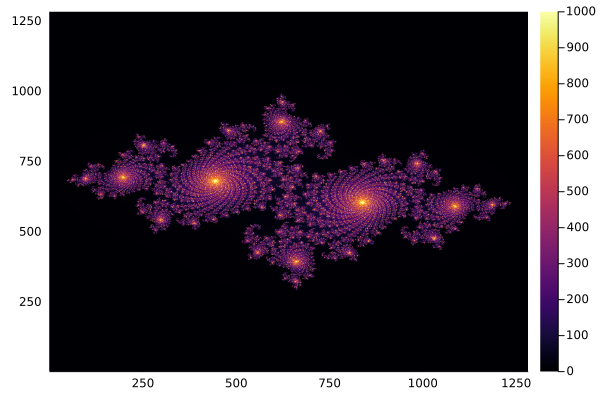

In [8]:
plotJulia(c);

In [ ]:
#plotIterates(sin(π),−0.20509091+0.71591*im,1000)
plotIterates(tan(π),−0.20509091+0.71591*im,10000)

In [ ]:
# Plot the fractal
plotJulia(−0.20509091+0.71591*im)

In [ ]:
# Source: https://discourse.julialang.org/t/how-to-plot-fractals-using-plots-and-gr/85054

using Plots, LinearAlgebra
gr()

"""
    plotIterates
Plots iteratations of the Julia function from in initial point z₀ ∈ ℂ and parameter c
    
Parameters
    z₀: Starting point
    c:  Control parameter
    n:  Number of iteratations
    
Returns
    Plot of n iteratations
"""
function plotIterates(z₀,c,n)
    # Initialize trajectory
    zₙ = length(z₀)
    traj = zeros(ComplexF64,n,zₙ)
    traj[1,:] .= z₀
    
    # Generate trajectory
    for k = 1:zₙ
        for j = 2:n
            traj[j,k] = traj[j-1,k]^2 + c
        end
    end  

    # Plot trajectory. The display function is needed inside a function.
    crvLabel = Array{String}(undef,zₙ)
    for k = 1:zₙ
        crvLabel[k] = string("z₀ = ", z₀[k])
    end
    # Note permation of label string. 
    # Ref: https://discourse.julialang.org/t/transpose-of-an-array-of-strings/40431/8
    crvPlot = plot(traj,
                   linewidth = 3,
                   aspect_ratio = 1,
                   xlabel = "Real axis",
                   ylabel = "Imag axis",
                   title = "Julia Iterates",
                   arrow = :arrow)
                   #label = permutedims(crvLabel)
                   #legend = :outertopright)
    display(crvPlot)

    # Return trajectory
    return traj

end

"""
    plotJulia
Plots points in a Julia set
Parameters
    c: Constant added to each iterate
"""
function plotJulia(c::Complex{T}; 
        xRng = [-1.5,1.5], yRng = [-1.5, 1.5], maxIters=100) where T<:Real
    
    # Array of iteration counts
    nx = 1281
    ny = 1281
    iterCounts = zeros(nx,ny)
    # Locations 
    xLocs = range(minimum(xRng),stop = maximum(xRng),length = nx)
    yLocs = range(minimum(yRng),stop = maximum(yRng),length = ny)
    # Loop over x,y locations iterating until maxIter reached, or |z|² > 4
    maxIters = 1000
    for j = 1:nx
        for k = 1:ny
            z = xLocs[j] + yLocs[k]im
            while iterCounts[j,k] < maxIters && norm(z) < 2
                z = z^2 + c
                iterCounts[j,k] += 1
            end
        end
    end

    # Display Julia set as a heatmap
    display(heatmap(iterCounts'))

    # Return array of iterations
    return iterCounts
   
end

In [ ]:
itc= plotJulia( -0.04 - 0.6841im; maxIters=500) 
heatmap(itc',  c = :matter, size=(400, 300)) 

In [ ]:
itc= plotJulia( -0.04 - 0.6841im; maxIters=500) 
heatmap(itc',  c = :matter, size=(400, 300)) 

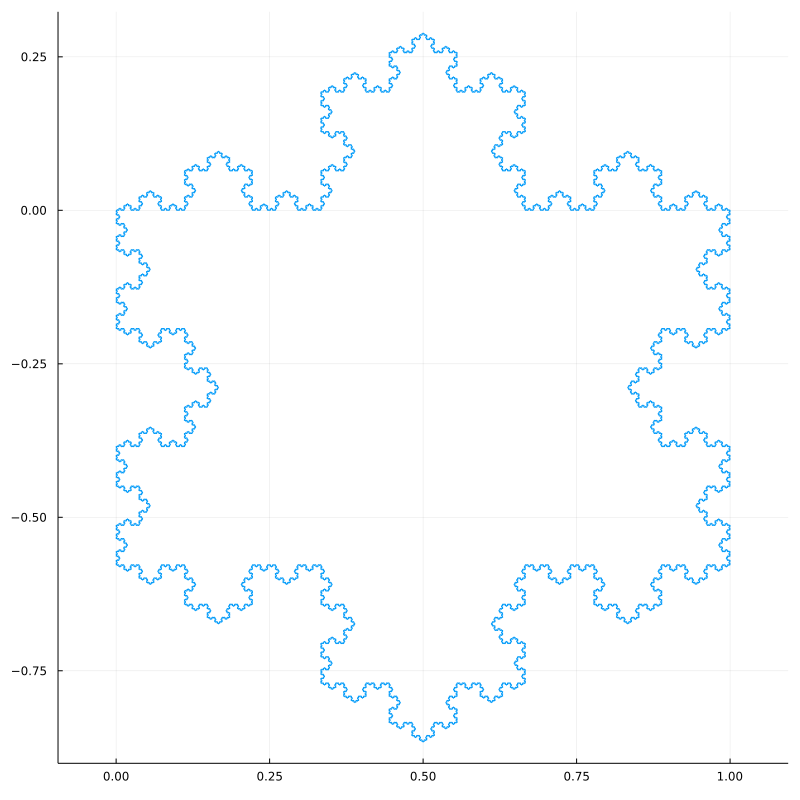

In [3]:
# Koch snowflakes
using Plots, StaticArrays
gr()

const θ = π/3; const m = SA[cos(θ) -sin(θ); sin(θ) cos(θ)]
const p = SA[1/3,0]; const q = p + m*p; const r = 2p
f(n) = n == 0 ? [0,0] : (v = f(n-1)/3; [v p.+m*v q.+m'*v r.+v])
a = f(6); b = [a [1,0] .+ (m*m)'*a [1/2,-sin(θ)] .+ (m*m)*a [0,0]]
plot(b[1,:], b[2,:]; aspect_ratio=1, size=(800,800), legend=false)

┌ Info: Saved animation to 
│   fn = /home/browni/LasthrimProjection/JupyterLab/tmp.gif
└ @ Plots /home/browni/.julia/packages/Plots/SkUg1/src/animation.jl:126


Plots.AnimatedGif("/home/browni/LasthrimProjection/JupyterLab/tmp.gif")
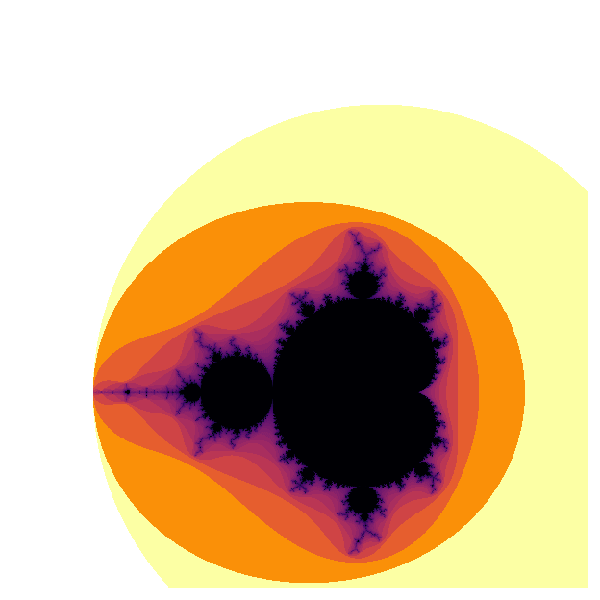

In [3]:
# Create animation of fractal
using Plots
exprange(start, stop, len) = exp.(range(log(start), log(stop), length=len))
function mandelbrot(z; lim=75) w = z
    for n = 1:lim;  abs2(w) < 4 ? w = w^2 + z : return n end
    lim + 1
end

function mandelbread(z; lim=75) w = z
    for n = 1:lim;  abs2(w) < 4 ? w = w/2 + z : return n end
    lim + 1
end

x₀, y₀ = -0.5626805, 0.6422555
anim = @animate for (r, l) in zip(exprange(2, 1.35e-6, 120), exprange(100, 2500, 120))
    x = range(x₀-r, x₀+r; length=600); y = range(y₀-r, y₀+r; length=600);
    heatmap(x, y, -log.(log.(mandelbrot.(x' .+ y .* im; lim=round(l))));
        legend=:none, border=:none, ticks=:none, size=(600,600), ratio=1)
end
g = gif(anim; fps=12)

## 10.14 Chaos

## 10.21 Convert Matrix of Ints to Image

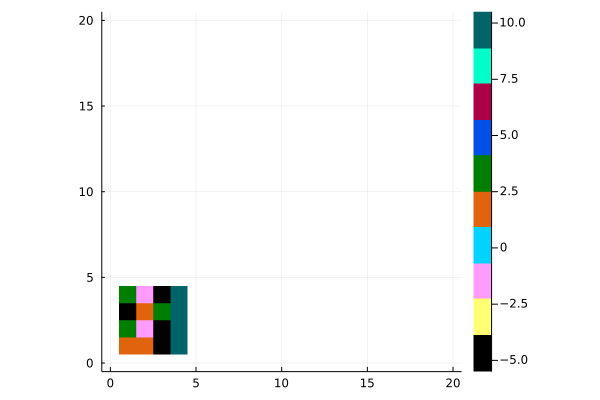

In [16]:
using Plots
n = 10
A = [1.5 2 -4 50; 
     3 -1 -6 35; 
     -10 2.3 4 13;
     3 -1 -6 9]

dc = distinguishable_colors(n)
heatmap(A, color=palette(dc, n), lims=(-0.5,20.5), ratio=1, clims=(-5.5,n+0.5))

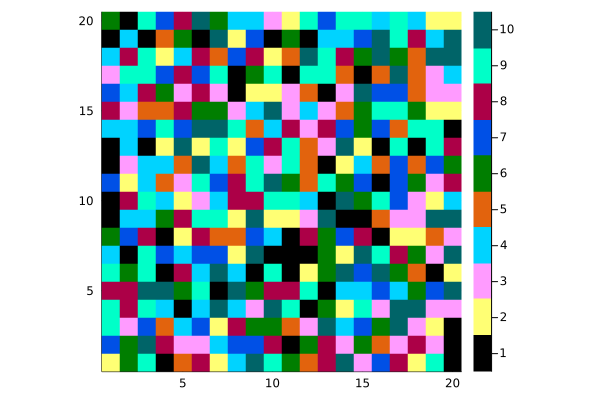

In [5]:
using Plots
n = 10
M = rand(1:n,20,20)
dc = distinguishable_colors(n)
heatmap(M, color=palette(dc, n), lims=(0.5,20.5), ratio=1, clims=(0.5,n+0.5))

# Appendix

In [5]:
# Check packages status 

using Pkg
Pkg.status.(("LaTeXStrings","Distances"))

      Status `~/LasthrimProjection/Project.toml`
  [b964fa9f] LaTeXStrings v1.3.0
      Status `~/LasthrimProjection/Project.toml`
  [b4f34e82] Distances v0.10.7


(nothing, nothing)

In [4]:
using Pkg
Pkg.add("LaTeXStrings")

    Updating registry at `~/.julia/registries/General.toml`
Unhandled Task ERROR: IOError: FDWatcher: bad file descriptor (EBADF)
Stacktrace:
 [1] try_yieldto(undo::typeof(Base.ensure_rescheduled))
   @ Base ./task.jl:812
 [2] wait()
   @ Base ./task.jl:872
 [3] wait(c::Base.GenericCondition{Base.Threads.SpinLock})
   @ Base ./condition.jl:123
 [4] wait(fdw::FileWatching._FDWatcher; readable::Bool, writable::Bool)
   @ FileWatching ~/julia-1.7.3/share/julia/stdlib/v1.7/FileWatching/src/FileWatching.jl:533
 [5] wait
   @ ~/julia-1.7.3/share/julia/stdlib/v1.7/FileWatching/src/FileWatching.jl:504 [inlined]
 [6] macro expansion
   @ ~/julia-1.7.3/share/julia/stdlib/v1.7/Downloads/src/Curl/Multi.jl:166 [inlined]
 [7] (::Downloads.Curl.var"#40#46"{Int32, FileWatching.FDWatcher, Downloads.Curl.Multi})()
   @ Downloads.Curl ./task.jl:429
┌ Warning: could not download https://pkg.julialang.org/registries
│   exception = Downloads.RequestError("https://pkg.julialang.org/registries", 28, "Failed 